<a href="https://colab.research.google.com/github/AdrienJ0/Chest-X-Rays-project/blob/main/Chest_X_Rays_Classifier.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Objective

The objective of this notebook to create models able to **classify** Chest X-rays images.

There are **12 classes of pathology** to classify: Atelectasis, Cardiomegaly, Consolidation, Edema, Effusion, Emphysema, Fibrosis, Hernia, Infiltration, Mass, Nodule, Pleural_Thickening, Pneumonia, Pneumothorax

In [34]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [35]:
import pandas as pd
import numpy as np
import seaborn as sn
import matplotlib.pyplot as plt
import datetime
import os
from PIL import Image
import tensorflow as tf
from keras.applications.densenet import DenseNet121
from keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras import regularizers
from keras.models import Model
from keras.models import load_model
from sklearn import metrics
from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score, roc_curve, precision_recall_curve, f1_score

import cv2
import matplotlib.pyplot as plt

from keras import backend as K
from keras.models import load_model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image



from keras.models import Sequential
from keras.layers import BatchNormalization, Conv2D, MaxPooling2D, Activation, Flatten, Dropout, Dense
from keras import backend as K

from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from sklearn.utils.class_weight import compute_class_weight

import matplotlib.patches as patches

 Note that due to computational limitations, we will only use a single sample of this dataset: Approximately **~1000** for training data, **~200** for validation data and **~400** for test data.

**NB :**These data sets  has already been properly separated by avoiding the "Patient Overlap and data leakage problem"

In [36]:
train_data=pd.read_csv("/content/drive/MyDrive/Data/train-small.csv")
test_data=pd.read_csv("/content/drive/MyDrive/Data/test.csv")
val_data=pd.read_csv("/content/drive/MyDrive/Data/valid-small.csv")


In [37]:
train_data

,Image,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,PatientId,Pleural_Thickening,Pneumonia,Pneumothorax
0,00008270_015.png,0,0,0,0,0,0,0,0,0,0,0,8270,0,0,0
1,00029855_001.png,1,0,0,0,1,0,0,0,1,0,0,29855,0,0,0
2,00001297_000.png,0,0,0,0,0,0,0,0,0,0,0,1297,1,0,0
3,00012359_002.png,0,0,0,0,0,0,0,0,0,0,0,12359,0,0,0
4,00017951_001.png,0,0,0,0,0,0,0,0,1,0,0,17951,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,00015869_010.png,0,0,0,0,0,0,0,0,0,0,0,15869,0,0,0
996,00020113_005.png,0,0,0,0,1,0,0,0,0,0,0,20113,0,0,0
997,00019939_000.png,0,0,0,0,0,0,0,0,0,0,0,19939,0,0,0
998,00030496_000.png,0,0,0,0,0,0,0,0,0,0,0,30496,0,0,0


In [38]:
c=train_data.drop(["PatientId" , "Image"],axis=1).columns
labels = list(c)

# Data Exploration

In [39]:
#Number of Unique Patients
train_data['PatientId'].nunique()

928

In [40]:
print(f'The pathologies present in the dataset are : {labels}')

The pathologies present in the dataset are : ['Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


In [41]:
train_data['No_pathology'] = (train_data[labels] == 0).all(axis = 'columns').astype(int)

In [42]:
for pathology in labels:
  print(f"There are N = {train_data[pathology].sum():<3} cases corresponding to the pathology {pathology}")

There are N = 106 cases corresponding to the pathology Atelectasis
There are N = 20  cases corresponding to the pathology Cardiomegaly
There are N = 33  cases corresponding to the pathology Consolidation
There are N = 16  cases corresponding to the pathology Edema
There are N = 128 cases corresponding to the pathology Effusion
There are N = 13  cases corresponding to the pathology Emphysema
There are N = 14  cases corresponding to the pathology Fibrosis
There are N = 2   cases corresponding to the pathology Hernia
There are N = 175 cases corresponding to the pathology Infiltration
There are N = 45  cases corresponding to the pathology Mass
There are N = 54  cases corresponding to the pathology Nodule
There are N = 21  cases corresponding to the pathology Pleural_Thickening
There are N = 10  cases corresponding to the pathology Pneumonia
There are N = 38  cases corresponding to the pathology Pneumothorax


In [43]:
print(f"There are N = {train_data['No_pathology'].sum():<3} cases without pathology")

There are N = 562 cases without pathology


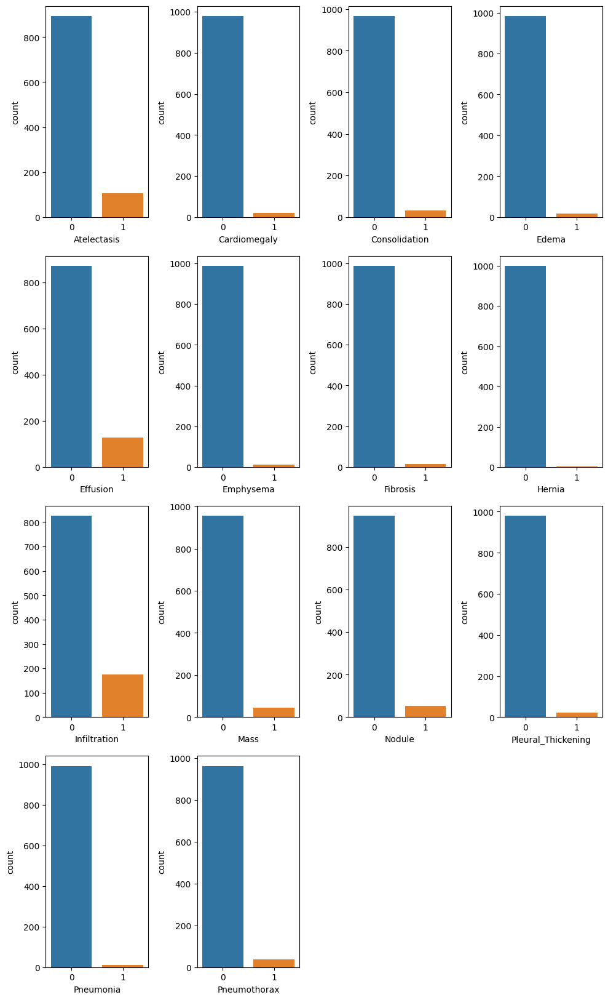

In [44]:
plt.figure(figsize=(10,20))
for i , j in enumerate(c) :
    plt.subplot(5, 4,i+1)
    sn.countplot(x=train_data[j])
plt.tight_layout()

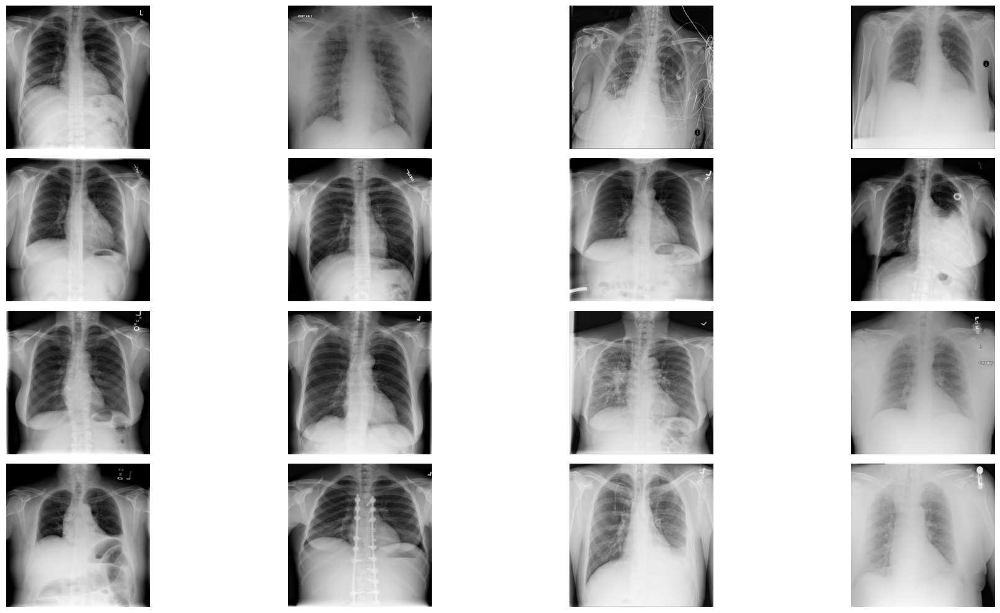

In [45]:
#Plot random images
images = train_data['Image'].values
random_images = [np.random.choice(images) for i in range(16)]
img_dir = '/content/drive/MyDrive/Data/images-small/'

plt.figure(figsize=(20,10))
for i in range(16):
    plt.subplot(4, 4, i + 1)
    img = plt.imread(os.path.join(img_dir, random_images[i]))
    plt.imshow(img, cmap='gray')
    plt.axis('off')

plt.tight_layout()

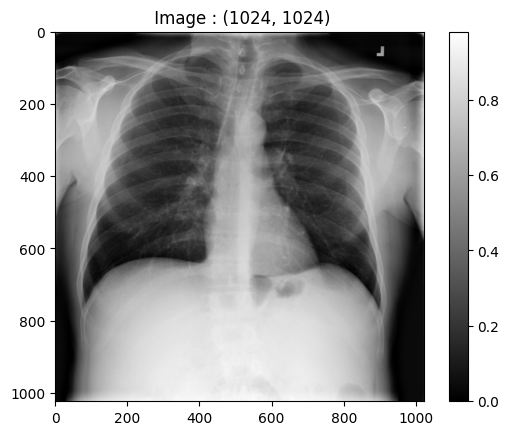

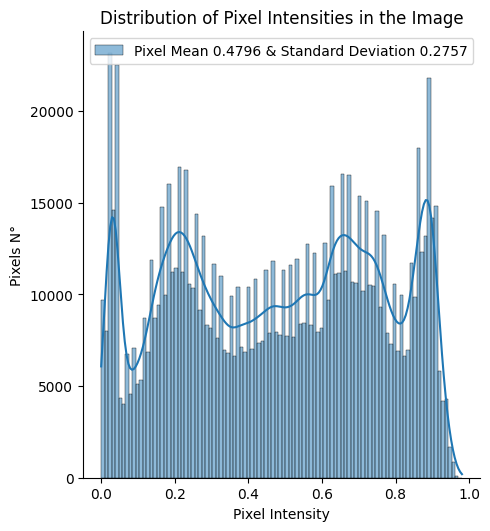

In [46]:
def afficher_image_distribution(img):
    raw_image = plt.imread(os.path.join(img_dir, img))
    plt.imshow(raw_image, cmap='gray')
    plt.colorbar()
    plt.title(f' Image : {raw_image.shape}')


    sn.displot(raw_image.ravel(),
                 label=f'Pixel Mean {np.mean(raw_image):.4f} & Standard Deviation {np.std(raw_image):.4f}', kde=True)
    plt.legend(loc='upper center')
    plt.title('Distribution of Pixel Intensities in the Image')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Pixels N°')

afficher_image_distribution(train_data.Image[0])

# Data Preprocessing

An analysis of the data reveals a class imbalance. We will deal with this problem as an optimisation later. What is done in this data pre-processing section is :


*   **Resize the Image pixel values data between 0 and 1**
*   **Shuffle the input after each epoch**
*   **Normalise the data**


This is done using the **ImageGenerator Class** in keras and what is also important is that we also define **the batch size** and **shape of the data** (320px by 320px), which is important for training of our models.

What we need to do is normalize incoming test data using the statistics computed from the training set.
* This process is enacted through the function provided below.
* It's important to note a technical aspect. In an ideal scenario, we would compute the mean and standard deviation using the complete training set. However, due to its extensive size, this approach would be exceedingly time-consuming.
* To expedite the process, we'll extract a random sample from the dataset and determine the sample mean and sample standard deviation.

In [79]:
def get_train_generator(df, image_dir, x_col, y_cols, shuffle=True, batch_size=16, seed=1, target_w = 320, target_h = 320):

    print("getting train generator...")
    # normalize images
    image_generator = ImageDataGenerator(
        samplewise_center=True,
        samplewise_std_normalization= True)


    generator = image_generator.flow_from_dataframe(
            dataframe=df,
            directory=image_dir,
            x_col=x_col,
            y_col=y_cols,
            class_mode="raw",
            batch_size=batch_size,
            shuffle=shuffle,
            seed=seed,
            target_size=(target_w,target_h))

    return generator

def get_test_and_valid_generator(valid_df, test_df, train_df, image_dir, x_col, y_cols, sample_size=16, batch_size=64, seed=1, target_w = 320, target_h = 320):


    print("getting valid and test generators...")

    raw_train_generator = ImageDataGenerator().flow_from_dataframe(
        dataframe=train_df,
        directory=IMAGE_DIR,
        x_col="Image",
        y_col=labels,
        class_mode="raw",
        batch_size=sample_size,
        shuffle=True,
        target_size=(target_w, target_h))


    batch = raw_train_generator.next()
    data_sample = batch[0]


    image_generator = ImageDataGenerator(
        featurewise_center=True,
        featurewise_std_normalization= True)

    image_generator.fit(data_sample)

    valid_generator = image_generator.flow_from_dataframe(
            dataframe=valid_df,
            directory=image_dir,
            x_col=x_col,
            y_col=y_cols,
            class_mode="raw",
            batch_size=batch_size,
            shuffle=False,
            seed=seed,
            validate_filenames=True,
            target_size=(target_w,target_h))

    test_generator = image_generator.flow_from_dataframe(
            dataframe=test_df,
            directory=image_dir,
            x_col=x_col,
            y_col=y_cols,
            class_mode="raw",
            batch_size=1,
            shuffle=True,
            seed=seed,
            target_size=(target_w,target_h))

    return valid_generator, test_generator , data_sample

In [80]:
IMAGE_DIR = "/content/drive/MyDrive/Data/images-small/"
train_generator = get_train_generator(train_data, IMAGE_DIR, "Image", labels)
val_generator, test_generator , data_sample= get_test_and_valid_generator(val_data, test_data, train_data, IMAGE_DIR, "Image", labels)

getting train generator...
Found 1000 validated image filenames.
getting valid and test generators...
Found 1000 validated image filenames.
Found 200 validated image filenames.
Found 420 validated image filenames.


# Models Implementation

We define a function to display the roc curve with the AUC score for each label

In [ ]:

def get_roc_curve(labels, predicted_vals, true_vals):
    auc_roc_vals = []
    for i in range(len(labels)):

          gt = true_vals[:, i]
          pred = predicted_vals[:, i]
          auc_roc = roc_auc_score(gt, pred)
          auc_roc_vals.append(auc_roc)
          fpr_rf, tpr_rf, _ = roc_curve(gt, pred)
          plt.figure(1, figsize=(10, 10))
          plt.plot([0, 1], [0, 1], 'k--')
          plt.plot(fpr_rf, tpr_rf,
                    label=labels[i] + " (" + str(round(auc_roc, 3)) + ")")
          plt.xlabel('False positive rate')
          plt.ylabel('True positive rate')
          plt.title('ROC curve')
          plt.legend(loc='best')

    plt.show()
    return auc_roc_vals

To respect the academic context of this project as much as possible, we are using different architectures seen in class in order to evaluate the results of these different models:
* **Densenet as feature extractor**
* **Densent with some unfrozen layers**
* **Vision Transformers**
* **RNN**
* **CNN combined with RNN**

And for each model we decide to display the **AUC** on Validation Data as the performance metric (here the AUC firstly to avoid working with metrics involving the setting of a given threshold because the AUC is independent of a specific threshold and mainly because we can calculate the average of the AUC which is very often used as the benchmark performance metric for this problem). The **loss Val and Loss Train** will be used in addition to the AUC to select the best performing model.

**NB :** We are not dealing with the problem of class imbalance at this stage.

## DenseNet

### ( as feature extractor )

In [ ]:
# create the base pre-trained model
base_model = DenseNet121(weights='imagenet', include_top=False)

x = base_model.output
x = GlobalAveragePooling2D()(x)
predictions = Dense(len(labels), activation="sigmoid")(x)
# define the callbacks

Densenet_model = Model(inputs=base_model.input, outputs=predictions)
checkpoint = ModelCheckpoint('/content/drive/MyDrive/tmp/checkpoint/DenseNet_FE_model_weights.h5', monitor='val_loss', save_best_only=True, save_weights_only=False, mode='min', verbose=1)
early_stop = EarlyStopping(monitor='val_loss', patience=10, mode='min', verbose=1)
log_dir = "/content/drive/MyDrive/logs/fit/" + "densenset "+ datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
Densenet_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy' ,tf.keras.metrics.AUC(multi_label = True)])
STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=val_generator.n//val_generator.batch_size

history = Densenet_model.fit(train_generator, validation_data=val_generator , steps_per_epoch = STEP_SIZE_TRAIN, epochs=20, validation_steps=STEP_SIZE_VALID ,callbacks=[checkpoint, early_stop,tensorboard_callback] )


Epoch 1/20
62/62 [==============================] - ETA: 0s - loss: 0.1965 - accuracy: 0.1169 - auc: 0.5344
Epoch 1: val_loss improved from inf to 7.76757, saving model to /content/drive/MyDrive/tmp/checkpoint/DenseNet_FE_model_weights.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 553s 7s/step - loss: 0.1965 - accuracy: 0.1169 - auc: 0.5344 - val_loss: 7.7676 - val_accuracy: 0.0833 - val_auc: 0.4295
Epoch 2/20
62/62 [==============================] - ETA: 0s - loss: 0.1622 - accuracy: 0.2012 - auc: 0.6060
Epoch 2: val_loss improved from 7.76757 to 0.24074, saving model to /content/drive/MyDrive/tmp/checkpoint/DenseNet_FE_model_weights.h5
62/62 [==============================] - 37s 591ms/step - loss: 0.1622 - accuracy: 0.2012 - auc: 0.6060 - val_loss: 0.2407 - val_accuracy: 0.0833 - val_auc: 0.5569
Epoch 3/20
62/62 [==============================] - ETA: 0s - loss: 0.1605 - accuracy: 0.1992 - auc: 0.6215
Epoch 3: val_loss improved from 0.24074 to 0.19512, saving model to /content/drive/MyDrive/tmp/checkpoint/DenseNet_FE_model_weights.h5
62/62 [==============================] - 37s 595ms/step - loss: 0.1605 - accuracy: 0.1992 - auc: 0.6215 - val_loss: 0.1951 - val_accuracy: 0.0521 - val_auc: 0.5754
Epoch 4/20
62/62 [======

In [ ]:
"""print(Densenet_model.metrics_names)
Densenet_model.evaluate_generator(generator=val_generator,
steps=1)"""


['loss', 'accuracy', 'auc_1']


<ipython-input-19-565d49330ae3>:2: UserWarning: `Model.evaluate_generator` is deprecated and will be removed in a future version. Please use `Model.evaluate`, which supports generators.
  Densenet_model.evaluate_generator(generator=val_generator,


[0.03840292617678642, 0.265625, 0.7130098342895508]

4/4 [==============================] - 6s 855ms/step


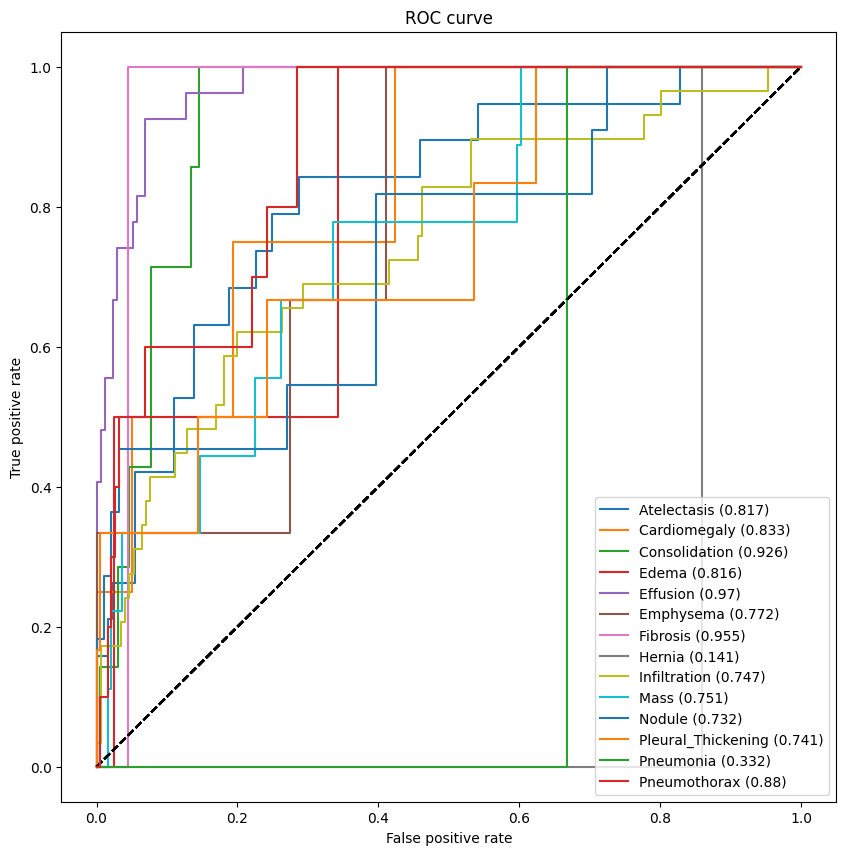

[0.8168072113986624,
 0.832908163265306,
 0.9259807549962991,
 0.8156565656565656,
 0.9698137443802184,
 0.7715736040609137,
 0.9547738693467337,
 0.14070351758793975,
 0.7473280903407945,
 0.7510180337405469,
 0.7316017316017316,
 0.7414089347079038,
 0.3316582914572864,
 0.88]

In [ ]:
Densenet_model=load_model('/content/drive/MyDrive/tmp/checkpoint/DenseNet_FE_model_weights.h5')
Densenet_predicted_vals = Densenet_model.predict(val_generator, batch_size = len(val_generator))
get_roc_curve(labels, Densenet_predicted_vals, val_generator.labels)


### Fine Tuned ( with 9 Last Layers freezed )

In [ ]:
# create the base pre-trained model
base_model = DenseNet121(weights='imagenet', include_top=False)

# We freeze last 9 layers
for layer in base_model.layers[:-9]:
    layer.trainable= False

x = base_model.output
x = GlobalAveragePooling2D()(x)
# Add L2 regularization to a Dense layer
x = Dense(512, activation='relu', kernel_regularizer=regularizers.l2(0.01))(x)

# Add L2 regularization to another Dense layer
x = Dense(256, activation='relu', kernel_regularizer=regularizers.l2(0.01))(x)

# Add L1 regularization to a Dense layer
x = Dense(128, activation='relu', kernel_regularizer=regularizers.l1(0.01))(x)

predictions = Dense(len(labels), activation="sigmoid")(x)
# define the callbacks

Densenet_model_2 = Model(inputs=base_model.input, outputs=predictions)
checkpoint = ModelCheckpoint('/content/drive/MyDrive/tmp/checkpoint/DenseNet_FT_model_weights.h5', monitor='val_loss', save_best_only=True, save_weights_only=False, mode='min', verbose=1)
early_stop = EarlyStopping(monitor='val_loss', patience=10, mode='min', verbose=1)
log_dir = "/content/drive/MyDrive/logs/fit/" + "densenset2 "+ datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)


Densenet_model_2.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy' ,tf.keras.metrics.AUC(multi_label = True)])
STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=val_generator.n//val_generator.batch_size

history = Densenet_model_2.fit(train_generator, validation_data=val_generator , steps_per_epoch = STEP_SIZE_TRAIN, epochs=20, validation_steps=STEP_SIZE_VALID ,callbacks=[checkpoint, early_stop,tensorboard_callback] )


Epoch 1/20
62/62 [==============================] - ETA: 0s - loss: 16.4234 - accuracy: 0.1890 - auc_3: 0.5351
Epoch 1: val_loss improved from inf to 6.36461, saving model to /content/drive/MyDrive/tmp/checkpoint/DenseNet_FT_model_weights.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 44s 554ms/step - loss: 16.4234 - accuracy: 0.1890 - auc_3: 0.5351 - val_loss: 6.3646 - val_accuracy: 0.0781 - val_auc_3: 0.5885
Epoch 2/20
62/62 [==============================] - ETA: 0s - loss: 2.5414 - accuracy: 0.0955 - auc_3: 0.6265
Epoch 2: val_loss improved from 6.36461 to 0.46947, saving model to /content/drive/MyDrive/tmp/checkpoint/DenseNet_FT_model_weights.h5
62/62 [==============================] - 30s 488ms/step - loss: 2.5414 - accuracy: 0.0955 - auc_3: 0.6265 - val_loss: 0.4695 - val_accuracy: 0.0833 - val_auc_3: 0.6002
Epoch 3/20
62/62 [==============================] - ETA: 0s - loss: 0.3318 - accuracy: 0.1016 - auc_3: 0.6509
Epoch 3: val_loss improved from 0.46947 to 0.26260, saving model to /content/drive/MyDrive/tmp/checkpoint/DenseNet_FT_model_weights.h5
62/62 [==============================] - 33s 532ms/step - loss: 0.3318 - accuracy: 0.1016 - auc_3: 0.6509 - val_loss: 0.2626 - val_accuracy: 0.0833 - val_auc_3: 0.6403
Epoch

4/4 [==============================] - 5s 840ms/step


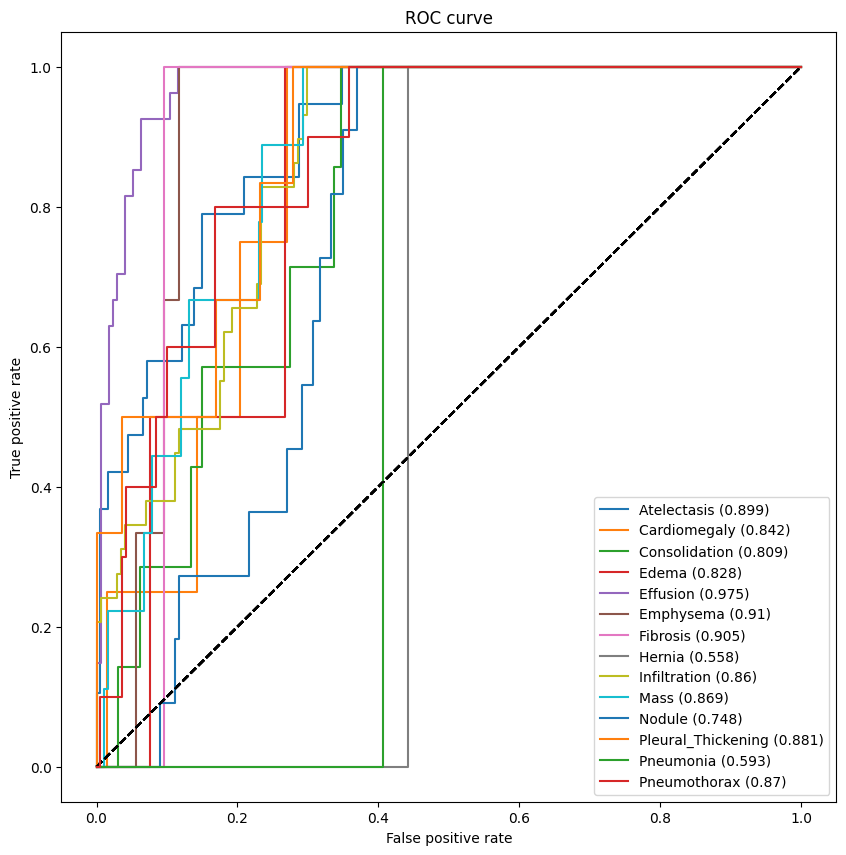

[0.8990985751671998,
 0.8418367346938775,
 0.8090303478904515,
 0.8282828282828283,
 0.9747377435238708,
 0.910321489001692,
 0.9045226130653267,
 0.5577889447236181,
 0.8604557370437588,
 0.8685282140779522,
 0.7479557479557479,
 0.8805841924398625,
 0.592964824120603,
 0.87]

In [ ]:
Densenet_model_2=load_model('/content/drive/MyDrive/tmp/checkpoint/DenseNet_FT_model_weights.h5')
Densenet2_predicted_vals = Densenet_model_2.predict(val_generator, batch_size = len(val_generator))
get_roc_curve(labels, Densenet2_predicted_vals, val_generator.labels)

## Transformers ( Vision Transformers )

In [ ]:
!pip install vit-keras==0.1.2
!pip install tensorflow-addons

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 612.3/612.3 kB 5.6 MB/s eta 0:00:00


In [ ]:
from tensorflow.keras.optimizers import Adam
from vit_keras import vit


/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [ ]:
from tensorflow.keras.optimizers import Adam
from vit_keras import vit


train_generator = get_train_generator(train_data, IMAGE_DIR, "Image", labels, target_w = 224, target_h = 224)
val_generator, test_generator  = get_test_and_valid_generator(val_data, test_data, train_data, IMAGE_DIR, "Image", labels, target_w = 224, target_h = 224)



# Load the ViT model
Vit_model = vit.vit_l32(weights='imagenet21k', image_size=224,activation='sigmoid', pretrained=True, include_top=True, pretrained_top=False, classes=len(labels))



# Define callbacks
checkpoint = ModelCheckpoint('/content/drive/MyDrive/tmp/checkpoint/model_VitTransf_weights.h5', monitor='val_loss', save_best_only=True, save_weights_only=False, mode='min', verbose=1)
early_stop = EarlyStopping(monitor='val_loss', patience=15, mode='min', verbose=1)
log_dir = "/content/drive/MyDrive/logs/fit/" +  datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
# Compile the model
Vit_model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=[ tf.keras.metrics.AUC(multi_label = True)])
STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=val_generator.n//val_generator.batch_size
# Train the model
Vit_model.fit(train_generator, validation_data=val_generator, steps_per_epoch = STEP_SIZE_TRAIN, epochs=20, validation_steps=STEP_SIZE_VALID , callbacks=[checkpoint, early_stop,tensorboard_callback])


/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


getting train generator...
Found 1000 validated image filenames.
getting valid and test generators...
Found 1000 validated image filenames.
Found 200 validated image filenames.
Found 420 validated image filenames.
1315932802/1315932802 [==============================] - 74s 0us/step
Epoch 1/20
62/62 [==============================] - ETA: 0s - loss: 0.1942 - auc_4: 0.4698
Epoch 1: val_loss improved from inf to 0.16591, saving model to /content/drive/MyDrive/tmp/checkpoint/model_VitTransf_weights.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 235s 2s/step - loss: 0.1942 - auc_4: 0.4698 - val_loss: 0.1659 - val_auc_4: 0.4355
Epoch 2/20
62/62 [==============================] - ETA: 0s - loss: 0.1790 - auc_4: 0.4839
Epoch 2: val_loss improved from 0.16591 to 0.16558, saving model to /content/drive/MyDrive/tmp/checkpoint/model_VitTransf_weights.h5
62/62 [==============================] - 328s 5s/step - loss: 0.1790 - auc_4: 0.4839 - val_loss: 0.1656 - val_auc_4: 0.4266
Epoch 3/20
62/62 [==============================] - ETA: 0s - loss: 0.1774 - auc_4: 0.4846
Epoch 3: val_loss did not improve from 0.16558
62/62 [==============================] - 108s 2s/step - loss: 0.1774 - auc_4: 0.4846 - val_loss: 0.1701 - val_auc_4: 0.4358
Epoch 4/20
62/62 [==============================] - ETA: 0s - loss: 0.1726 - auc_4: 0.4968
Epoch 4: val_loss did not improve from 0.16558
62/62 [==============================] - 107s 2s/step - loss: 0.1726 - auc_4: 0.4968 - val_loss: 0.1678 - val_auc_4: 0.4305
Epoc

In [ ]:
train_generator_for_VIT = get_train_generator(train_data, IMAGE_DIR, "Image", labels, target_w = 224, target_h = 224)
val_generator_for_VIT, test_generator_for_VIT  = get_test_and_valid_generator(val_data, test_data, train_data, IMAGE_DIR, "Image", labels, target_w = 224, target_h = 224)


getting train generator...
Found 1000 validated image filenames.
getting valid and test generators...
Found 1000 validated image filenames.
Found 200 validated image filenames.
Found 420 validated image filenames.


getting train generator...
Found 1000 validated image filenames.
getting valid and test generators...
Found 1000 validated image filenames.
Found 200 validated image filenames.
Found 420 validated image filenames.
4/4 [==============================] - 12s 467ms/step


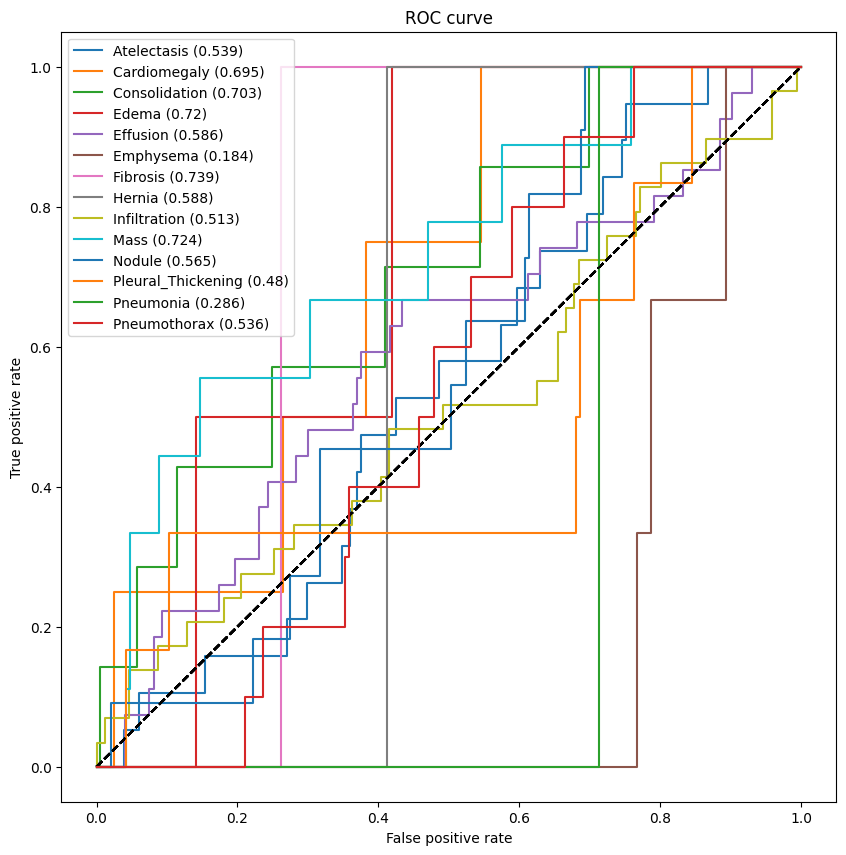

[0.5385286420471067,
 0.6951530612244898,
 0.703182827535159,
 0.7196969696969697,
 0.5859558980946264,
 0.1844331641285956,
 0.7386934673366834,
 0.5879396984924623,
 0.5126033474490825,
 0.7242582897033158,
 0.5651755651755652,
 0.4802405498281787,
 0.2864321608040201,
 0.5357894736842106]

In [ ]:
train_generator_for_VIT = get_train_generator(train_data, IMAGE_DIR, "Image", labels, target_w = 224, target_h = 224)
val_generator_for_VIT, test_generator_for_VIT  = get_test_and_valid_generator(val_data, test_data, train_data, IMAGE_DIR, "Image", labels, target_w = 224, target_h = 224)

Vit_Model=load_model('/content/drive/MyDrive/tmp/checkpoint/model_VitTransf_weights.h5')
Vit_predicted_vals = Vit_Model.predict(val_generator_for_VIT, steps = len(val_generator_for_VIT))

get_roc_curve(labels, Vit_predicted_vals, val_generator_for_VIT.labels)

## RNN adapted to Image classification

In [ ]:
Rnn_model = tf.keras.Sequential([
  tf.keras.Input(shape=(320,320,3)),
  tf.keras.layers.Reshape(target_shape=(320, 960)),
  tf.keras.layers.GRU(128),
  tf.keras.layers.Dense(128, activation='relu'),
  tf.keras.layers.Dropout(0.2,input_shape=(128,)),
  tf.keras.layers.Dense(len(labels), activation='sigmoid')
])
Rnn_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy' ,tf.keras.metrics.AUC(multi_label = True) ])

checkpoint = ModelCheckpoint('/content/drive/MyDrive/tmp/checkpoint/model_RNN_weights.h5', monitor='val_loss', save_best_only=True, save_weights_only=False, mode='min', verbose=1)
early_stop = EarlyStopping(monitor='val_loss', patience=10, mode='min', verbose=1)
log_dir = "/content/drive/MyDrive/logs/fit/" + "RNN" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

history = Rnn_model.fit(train_generator, epochs=20, validation_data=val_generator, callbacks=[checkpoint, early_stop ,tensorboard_callback])

Epoch 1/20
63/63 [==============================] - ETA: 0s - loss: 0.2232 - accuracy: 0.1740 - auc: 0.4707
Epoch 1: val_loss improved from inf to 0.16700, saving model to /content/drive/MyDrive/tmp/checkpoint/model_RNN_weights.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


63/63 [==============================] - 411s 6s/step - loss: 0.2232 - accuracy: 0.1740 - auc: 0.4707 - val_loss: 0.1670 - val_accuracy: 0.2700 - val_auc: 0.5699
Epoch 2/20
63/63 [==============================] - ETA: 0s - loss: 0.1805 - accuracy: 0.1930 - auc: 0.5202
Epoch 2: val_loss did not improve from 0.16700
63/63 [==============================] - 21s 333ms/step - loss: 0.1805 - accuracy: 0.1930 - auc: 0.5202 - val_loss: 0.1670 - val_accuracy: 0.1500 - val_auc: 0.5563
Epoch 3/20
63/63 [==============================] - ETA: 0s - loss: 0.1793 - accuracy: 0.1930 - auc: 0.5218
Epoch 3: val_loss improved from 0.16700 to 0.16371, saving model to /content/drive/MyDrive/tmp/checkpoint/model_RNN_weights.h5
63/63 [==============================] - 21s 332ms/step - loss: 0.1793 - accuracy: 0.1930 - auc: 0.5218 - val_loss: 0.1637 - val_accuracy: 0.1300 - val_auc: 0.5917
Epoch 4/20
63/63 [==============================] - ETA: 0s - loss: 0.1773 - accuracy: 0.1850 - auc: 0.5259
Epoch 4: val

4/4 [==============================] - 5s 726ms/step


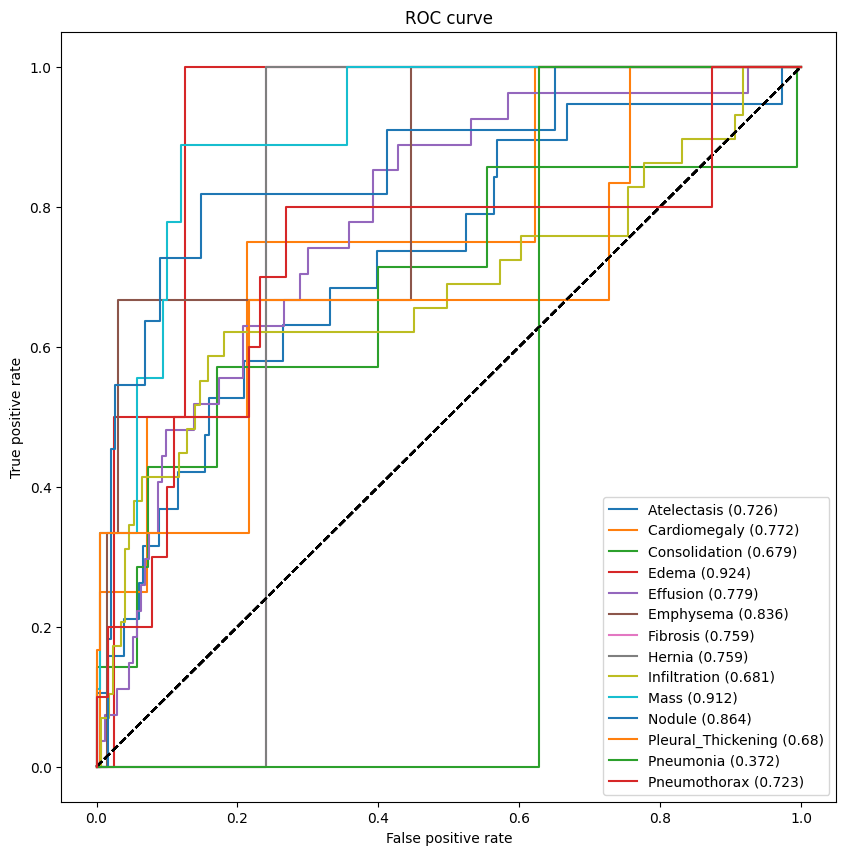

[0.7260831637103808,
 0.7716836734693877,
 0.6787564766839378,
 0.9242424242424242,
 0.778848212374224,
 0.8358714043993232,
 0.7587939698492463,
 0.7587939698492463,
 0.6809840693688243,
 0.9115764979639326,
 0.8643578643578643,
 0.679553264604811,
 0.371859296482412,
 0.7231578947368422]

In [ ]:
Rnn_model = load_model('/content/drive/MyDrive/tmp/checkpoint/model_RNN_weights.h5')
Rnn_predicted_vals = Rnn_model.predict(val_generator, steps = len(val_generator))

get_roc_curve(labels, Rnn_predicted_vals, val_generator.labels)

## RNN + CNN

In [ ]:
cnn = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=(320, 320, 3)),
    tf.keras.layers.MaxPooling2D((2, 2)),

])

# Calculate the shape of the output feature map from the CNN
cnn_output_shape = cnn.layers[-1].output_shape


rnn = tf.keras.Sequential([
    tf.keras.layers.Reshape(target_shape=(cnn_output_shape[1], cnn_output_shape[2] * cnn_output_shape[3])),
    tf.keras.layers.GRU(128),

])

# Combine the CNN and RNN
combined_model = tf.keras.Sequential([
    cnn,
    rnn,
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(len(labels), activation='sigmoid')
])

combined_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

checkpoint = ModelCheckpoint('/content/drive/MyDrive/tmp/checkpoint/model_GRURNN_weights.h5', monitor='val_loss', save_best_only=True, save_weights_only=False, mode='min', verbose=1)
early_stop = EarlyStopping(monitor='val_loss', patience=10, mode='min', verbose=1)
log_dir = "/content/drive/MyDrive/logs/fit/" + "cnnrnn "+datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

history = combined_model.fit(train_generator, epochs=20, validation_data=val_generator, callbacks=[checkpoint, early_stop,tensorboard_callback])

Epoch 1/20
63/63 [==============================] - ETA: 0s - loss: 0.2074 - accuracy: 0.1620
Epoch 1: val_loss improved from inf to 0.17380, saving model to /content/drive/MyDrive/tmp/checkpoint/model_GRURNN_weights.h5
63/63 [==============================] - 31s 385ms/step - loss: 0.2074 - accuracy: 0.1620 - val_loss: 0.1738 - val_accuracy: 0.0850
Epoch 2/20
63/63 [==============================] - ETA: 0s - loss: 0.1828 - accuracy: 0.1990
Epoch 2: val_loss improved from 0.17380 to 0.16849, saving model to /content/drive/MyDrive/tmp/checkpoint/model_GRURNN_weights.h5
63/63 [==============================] - 24s 381ms/step - loss: 0.1828 - accuracy: 0.1990 - val_loss: 0.1685 - val_accuracy: 0.0850
Epoch 3/20
63/63 [==============================] - ETA: 0s - loss: 0.1783 - accuracy: 0.1800
Epoch 3: val_loss improved from 0.16849 to 0.16654, saving model to /content/drive/MyDrive/tmp/checkpoint/model_GRURNN_weights.h5
63/63 [==============================] - 26s 415ms/step - loss: 0.17

4/4 [==============================] - 4s 921ms/step


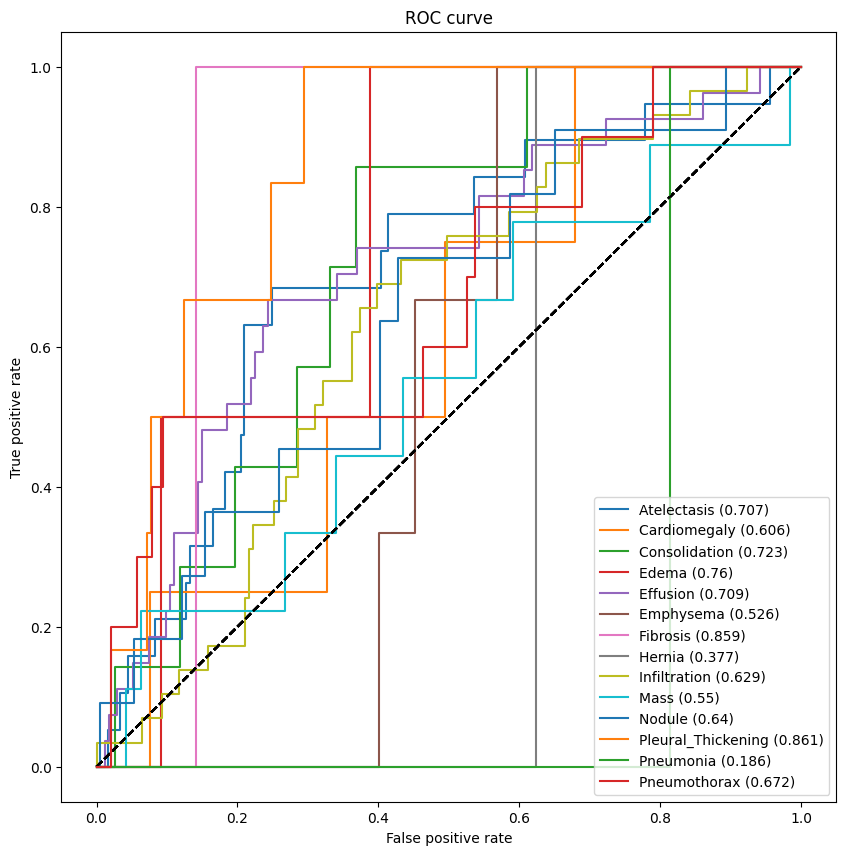

[0.707182320441989,
 0.6058673469387755,
 0.7231680236861584,
 0.7601010101010102,
 0.7090558766859345,
 0.5262267343485617,
 0.8592964824120604,
 0.37688442211055273,
 0.6293607582173826,
 0.5503199534613147,
 0.6402116402116402,
 0.8608247422680412,
 0.18592964824120606,
 0.6721052631578948]

In [ ]:
combined_model=load_model('/content/drive/MyDrive/tmp/checkpoint/model_GRURNN_weights.h5')
Rnn_Cnn_predicted_vals = combined_model.predict(val_generator, steps = len(val_generator))

get_roc_curve(labels, Rnn_Cnn_predicted_vals, val_generator.labels)

# AUC Visualisation per model


To simplify the comparison (AUC) of the models on our validation data , we summarise the results for all the models in the previous section, plus the AUC avg.

In [ ]:
Densenet_model=load_model('/content/drive/MyDrive/tmp/checkpoint/DenseNet_FE_model_weights.h5')
Densenet_model_2=load_model('/content/drive/MyDrive/tmp/checkpoint/DenseNet_FT_model_weights.h5')
rnn_cnn_model = load_model('/content/drive/MyDrive/tmp/checkpoint/model_GRURNN_weights.h5')
rnn_model = load_model('/content/drive/MyDrive/tmp/checkpoint/model_RNN_weights.h5')
vit_model = load_model('/content/drive/MyDrive/tmp/checkpoint/model_VitTransf_weights.h5')

In [ ]:
Densenet_predicted_vals = Densenet_model.predict(val_generator, batch_size = len(val_generator))
Densenet2_predicted_vals = Densenet_model_2.predict(val_generator, batch_size = len(val_generator))
rnn_cnn_predicted_vals = rnn_cnn_model.predict(val_generator, batch_size = len(val_generator))
rnn_predicted_vals = rnn_model.predict(val_generator, batch_size = len(val_generator))
vit_predicted_vals = vit_model.predict(val_generator_for_VIT, steps = len(val_generator_for_VIT))

4/4 [==============================] - 9s 757ms/step


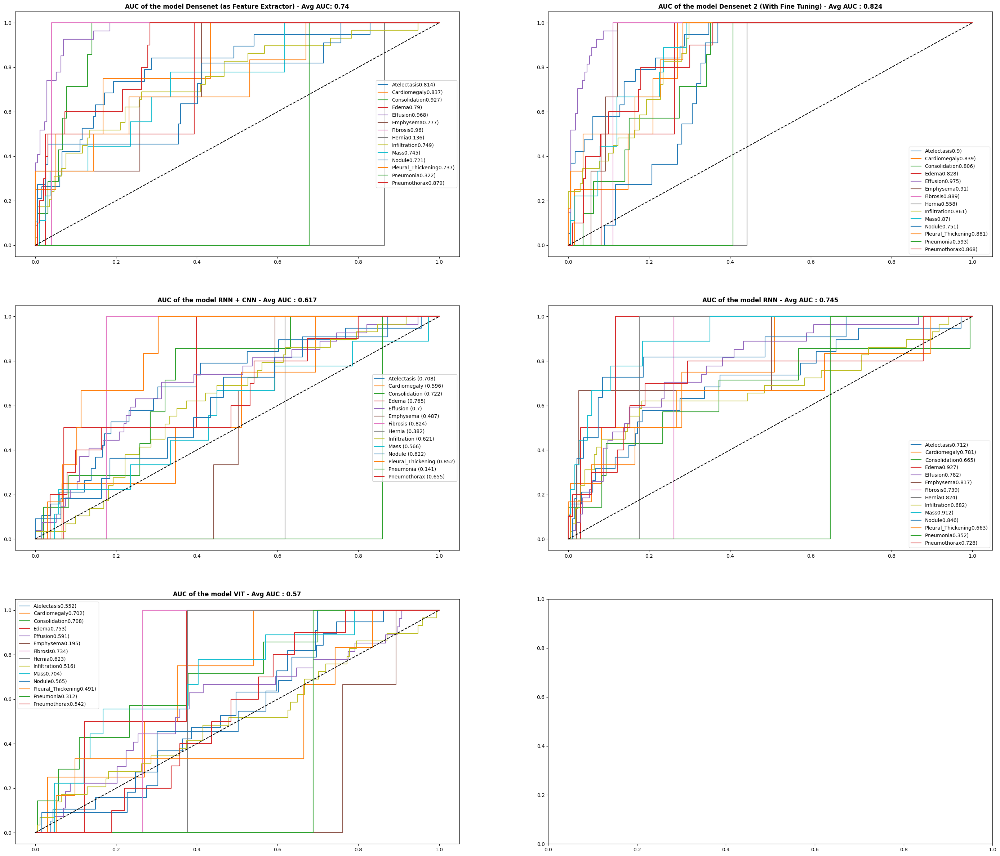

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_auc_score, roc_curve

fig, ((ax1, ax2), (ax3, ax4), (ax5, _)) = plt.subplots(3, 2, figsize=(35, 30))

auc_values_dense_net = []
auc_values_dense_net2 = []
auc_values_rnn_cnn = []
auc_values_rnn = []
auc_values_vit = []

for i in range(len(labels)):
    gt = (val_generator.labels)[:, i]
    gt_vit = (val_generator_for_VIT.labels)[:, i]
    pred_dense_net = Densenet_predicted_vals[:, i]
    pred_dense_net2 = Densenet2_predicted_vals[:, i]
    pred_rnn_cnn = rnn_cnn_predicted_vals[:, i]
    pred_rnn = rnn_predicted_vals[:, i]
    pred_vit = vit_predicted_vals[:, i]

    auc_roc_dense_net = roc_auc_score(gt, pred_dense_net)
    auc_roc_dense_net2 = roc_auc_score(gt, pred_dense_net2)
    auc_roc_rnn_cnn = roc_auc_score(gt, pred_rnn_cnn)
    auc_roc_rnn = roc_auc_score(gt, pred_rnn)
    auc_roc_vit = roc_auc_score(gt, pred_vit)

    fpr_dense_net, tpr_dense_net, _ = roc_curve(gt, pred_dense_net)
    fpr_dense_net2, tpr_dense_net2, _ = roc_curve(gt, pred_dense_net2)
    fpr_rnn_cnn, tpr_rnn_cnn, _ = roc_curve(gt, pred_rnn_cnn)
    fpr_rnn, tpr_rnn, _ = roc_curve(gt, pred_rnn)
    fpr_vit, tpr_vit, _ = roc_curve(gt_vit, pred_vit)

    # Append AUC values to lists
    auc_values_dense_net.append(auc_roc_dense_net)
    auc_values_dense_net2.append(auc_roc_dense_net2)
    auc_values_rnn_cnn.append(auc_roc_rnn_cnn)
    auc_values_rnn.append(auc_roc_rnn)
    auc_values_vit.append(auc_roc_vit)

    ax1.plot(fpr_dense_net, tpr_dense_net, label = labels[i] + str(round(auc_roc_dense_net,3)) + ")")
    ax2.plot(fpr_dense_net2, tpr_dense_net2, label = labels[i] + str(round(auc_roc_dense_net2,3)) + ")")
    ax3.plot(fpr_rnn_cnn, tpr_rnn_cnn, label = labels[i] +  " (" + str(round(auc_roc_rnn_cnn,3)) + ")")
    ax4.plot(fpr_rnn, tpr_rnn, label = labels[i] + str(round(auc_roc_rnn,3)) + ")")
    ax5.plot(fpr_vit, tpr_vit, label = labels[i] + str(round(auc_roc_vit,3)) + ")")

# Calculate average AUC values
avg_auc_dense_net = round(np.average(auc_values_dense_net) , 3)
avg_auc_dense_net2 = round(np.average(auc_values_dense_net2), 3)
avg_auc_rnn_cnn = round(np.average(auc_values_rnn_cnn), 3)
avg_auc_rnn = round(np.average(auc_values_rnn), 3)
avg_auc_vit = round(np.average(auc_values_vit), 3)

# plot titles
ax1.set_title(f"AUC of the model Densenet (as Feature Extractor) - Avg AUC: {avg_auc_dense_net}", fontweight='bold')
ax2.set_title(f"AUC of the model Densenet 2 (With Fine Tuning) - Avg AUC : {avg_auc_dense_net2}", fontweight='bold')
ax3.set_title(f"AUC of the model RNN + CNN - Avg AUC : {avg_auc_rnn_cnn}", fontweight='bold')
ax4.set_title(f"AUC of the model RNN - Avg AUC : {avg_auc_rnn}", fontweight='bold')
ax5.set_title(f"AUC of the model VIT - Avg AUC : {avg_auc_vit}", fontweight='bold')
for ax in [ax1, ax2, ax3, ax4, ax5]:
  ax.legend(loc='best')
  ax.plot([0, 1], [0, 1], 'k--')

plt.show()


# Model Optimization

## Model optimization with weighted loss (for dealing with Imbalance Class)

The graph below shows that the prevalence of positive cases varies considerably from one disease to another.

* The Hernia pathology has the greatest imbalance .
* But even the Infiltration pathology, which has the least amount of imbalance, has only 17.5% of the training cases labelled positive.

Ideally, we would train our model using an evenly balanced dataset so that the positive and negative training cases would contribute equally to the loss.

\begin{align*}
N &= \text{Total number of examples} \\
\text{The contribution of each class (i.e. positive or negative) is: } \\
\text{positive_frequencies} &= \frac{\text{positive examples}}{N} \quad \text{(Positive frequencies for each class)} \\
\text{negative_frequencies} &=  \frac{\text{negative examples}}{N} = 1 - \text{positive_frequencies} \quad \text{(Negative frequencies for each class)}
\end{align*}


\begin{align*}
\text{We can rewrite the overall average cross-entropy loss} & \text{ over the entire training set as follows:} \\
\text{weighted_loss}(\text{y_true}, \text{y_pred}) &= \text{loss_pos} + \text{loss_neg} \\
\text{loss_pos} &= -\frac{1}{N} \sum_{\text{negatives example}} \left(\text{pos_weights} \cdot \text{y_true} \cdot \log(\text{y_pred}) \right) \\
\text{loss_neg} &= -\frac{1}{N} \sum_\text{negatives example} \left(\text{neg_weights} \cdot (1 - \text{y\_true}) \cdot \log(1 - \text{y\_pred}) \right) \\
\text{With:} \\
\text{pos_weights} *\text{positive_frequencies} &= \text{neg_weights}*\text{negative_frequencies} \\
\text{which we can do simply by taking} \\
\text{pos_weights} &= \text{negative_frequencies} \\
\text{neg_weights} &= \text{positive_frequencies} \\
\end{align*}


In [ ]:
def compute_class_freqs(labels):

    # total number of patients (rows)
    N = labels.shape[0]

    positive_frequencies = np.sum(labels, axis = 0) / N
    negative_frequencies = 1 - positive_frequencies

    return positive_frequencies, negative_frequencies

In [ ]:
#We compute frequencies for our training data.
freq_pos, freq_neg = compute_class_freqs(train_generator.labels)

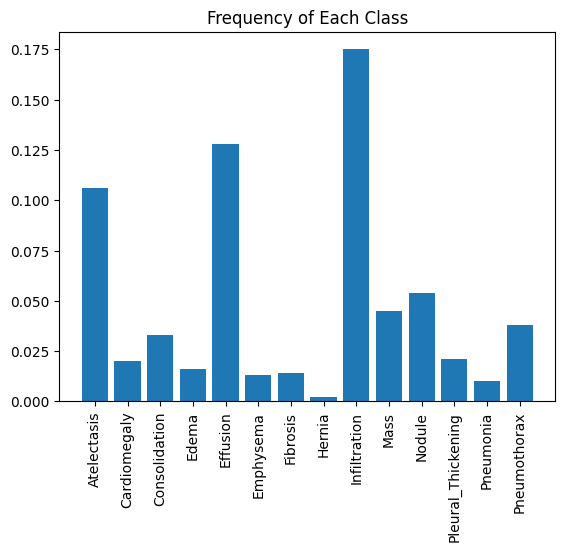

In [ ]:
plt.xticks(rotation=90)
plt.bar(x=labels, height=np.mean(train_generator.labels, axis=0))
plt.title("Frequency of Each Class")
plt.show()

In [ ]:
def get_weighted_loss(pos_weights, neg_weights, epsilon=1e-7):
    def weighted_loss(y_true, y_pred):

        loss = 0.0
        for i in range(len(pos_weights)):
            # for each class, add average weighted loss for that class
            y_true_float = tf.cast(y_true, tf.float32) # Convert y_true to float32
            loss_pos = -1 * K.mean(pos_weights[i] * y_true_float[:, i] * K.log(y_pred[:, i] + epsilon))
            loss_neg = -1 * K.mean(neg_weights[i] * (1 - y_true_float[:, i]) * K.log(1 - y_pred[:, i] + epsilon))
            loss += loss_pos + loss_neg

        return loss
    return weighted_loss

In [ ]:
pos_weights = freq_neg
neg_weights = freq_pos

<ipython-input-14-c4815a51dc02>:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data = data.append([{"Class": labels[l], "Label": "Negative", "Value": v}


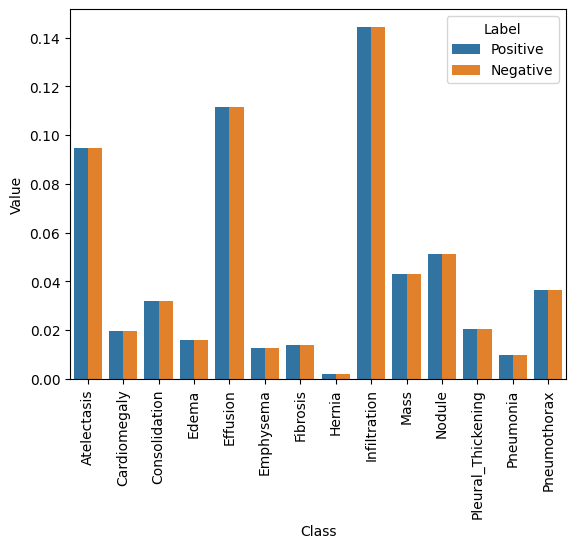

In [ ]:
pos_contribution = freq_pos * pos_weights
neg_contribution = freq_neg * neg_weights


data = pd.DataFrame({"Class": labels, "Label": "Positive", "Value": pos_contribution})
data = data.append([{"Class": labels[l], "Label": "Negative", "Value": v}
                        for l,v in enumerate(neg_contribution)], ignore_index=True)
plt.xticks(rotation=90)
sn.barplot(x="Class", y="Value", hue="Label" ,data=data);

As the above figure shows, by applying these weightings the positive and negative labels within each class would have the same aggregate contribution to the loss function. Now let's implement such a loss function.

### Densenet ( As Feature Extractor ) With Weighted Loss

In [ ]:
# create the base pre-trained model
base_model = DenseNet121(weights='imagenet', include_top=False)

x = base_model.output
x = GlobalAveragePooling2D()(x)
predictions = Dense(len(labels), activation="sigmoid")(x)
# define the callbacks

Densenet_model_with_WL = Model(inputs=base_model.input, outputs=predictions)
checkpoint = ModelCheckpoint('/content/drive/MyDrive/tmp/checkpoint/DenseNet_with_WL_FE_model.h5', monitor='val_loss', save_best_only=True, save_weights_only=False, mode='min', verbose=1)
early_stop = EarlyStopping(monitor='val_loss', patience=10, mode='min', verbose=1)
log_dir = "/content/drive/MyDrive/logs/fit/" + "densenset_with_WL "+ datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
Densenet_model_with_WL.compile(optimizer='adam', loss=get_weighted_loss(pos_weights, neg_weights), metrics=['accuracy' ,tf.keras.metrics.AUC(multi_label = True)])
STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=val_generator.n//val_generator.batch_size

history = Densenet_model_with_WL.fit(train_generator, validation_data=val_generator , steps_per_epoch = STEP_SIZE_TRAIN, epochs=20, validation_steps=STEP_SIZE_VALID ,callbacks=[checkpoint, early_stop,tensorboard_callback] )


29084464/29084464 [==============================] - 3s 0us/step
Epoch 1/20
62/62 [==============================] - ETA: 0s - loss: 0.8888 - accuracy: 0.0762 - auc: 0.5250 
Epoch 1: val_loss improved from inf to 9.15134, saving model to /content/drive/MyDrive/tmp/checkpoint/DenseNet_with_WL_FE_model.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 961s 14s/step - loss: 0.8888 - accuracy: 0.0762 - auc: 0.5250 - val_loss: 9.1513 - val_accuracy: 0.0156 - val_auc: 0.4137
Epoch 2/20
62/62 [==============================] - ETA: 0s - loss: 0.7977 - accuracy: 0.0793 - auc: 0.5843
Epoch 2: val_loss improved from 9.15134 to 7.58791, saving model to /content/drive/MyDrive/tmp/checkpoint/DenseNet_with_WL_FE_model.h5
62/62 [==============================] - 34s 552ms/step - loss: 0.7977 - accuracy: 0.0793 - auc: 0.5843 - val_loss: 7.5879 - val_accuracy: 0.0208 - val_auc: 0.4086
Epoch 3/20
62/62 [==============================] - ETA: 0s - loss: 0.7854 - accuracy: 0.0711 - auc: 0.6440
Epoch 3: val_loss improved from 7.58791 to 5.52495, saving model to /content/drive/MyDrive/tmp/checkpoint/DenseNet_with_WL_FE_model.h5
62/62 [==============================] - 34s 554ms/step - loss: 0.7854 - accuracy: 0.0711 - auc: 0.6440 - val_loss: 5.5250 - val_accuracy: 0.0260 - val_auc: 0.4528
Epoch 4/20
62/62 [=====

4/4 [==============================] - 6s 873ms/step


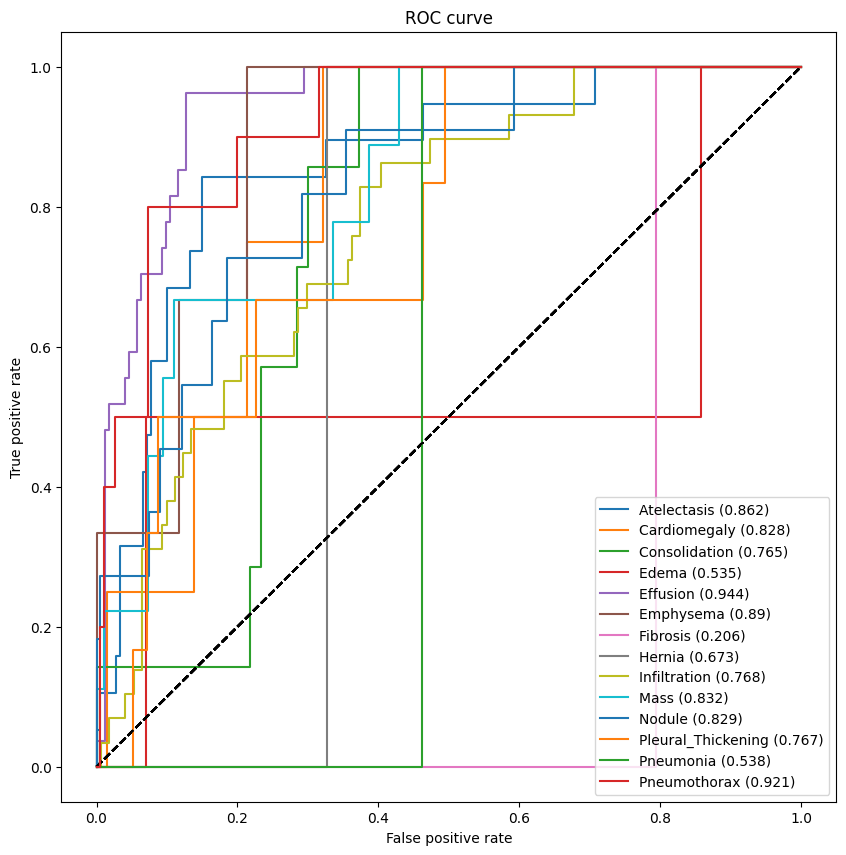

[0.8621692352428031,
 0.8278061224489797,
 0.765358993338268,
 0.5353535353535354,
 0.9441233140655105,
 0.8900169204737733,
 0.20603015075376885,
 0.6733668341708543,
 0.7683000604960678,
 0.8318789994182665,
 0.8292448292448292,
 0.7671821305841924,
 0.5376884422110553,
 0.9205263157894736]

In [ ]:
custom_objects = {'weighted_loss': get_weighted_loss}
Densenet_With_WL_model=load_model('/content/drive/MyDrive/tmp/checkpoint/DenseNet_with_WL_FE_model.h5', custom_objects=custom_objects)
Densenet_with_WL_predicted_vals = Densenet_With_WL_model.predict(val_generator, batch_size = len(val_generator))
get_roc_curve(labels, Densenet_with_WL_predicted_vals, val_generator.labels)

### Densenet( Fine Tunining ) With Weighted Loss

In [ ]:
# create the base pre-trained model
base_model = DenseNet121(weights='imagenet', include_top=False)

# We freeze last 9 layers
for layer in base_model.layers[:-9]:
    layer.trainable= False

x = base_model.output
x = GlobalAveragePooling2D()(x)
# Add L2 regularization to a Dense layer
x = Dense(512, activation='relu', kernel_regularizer=regularizers.l2(0.01))(x)

# Add L2 regularization to another Dense layer
x = Dense(256, activation='relu', kernel_regularizer=regularizers.l2(0.01))(x)

# Add L1 regularization to a Dense layer
x = Dense(128, activation='relu', kernel_regularizer=regularizers.l1(0.01))(x)

predictions = Dense(len(labels), activation="sigmoid")(x)
# define the callbacks

Densenet_model_with_WL_2 = Model(inputs=base_model.input, outputs=predictions)
checkpoint = ModelCheckpoint('/content/drive/MyDrive/tmp/checkpoint/DenseNet_With_WL_FT_model.h5', monitor='val_loss', save_best_only=True, save_weights_only=False, mode='min', verbose=1)
early_stop = EarlyStopping(monitor='val_loss', patience=10, mode='min', verbose=1)
log_dir = "/content/drive/MyDrive/logs/fit/" + "densenset_with_WL2 "+ datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)


Densenet_model_with_WL_2.compile(optimizer='adam', loss=get_weighted_loss(pos_weights, neg_weights), metrics=['accuracy' ,tf.keras.metrics.AUC(multi_label = True)])
STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=val_generator.n//val_generator.batch_size

history = Densenet_model_with_WL_2.fit(train_generator, validation_data=val_generator , steps_per_epoch = STEP_SIZE_TRAIN, epochs=20, validation_steps=STEP_SIZE_VALID ,callbacks=[checkpoint, early_stop,tensorboard_callback] )


Epoch 1/20
62/62 [==============================] - ETA: 0s - loss: 17.9907 - accuracy: 0.0671 - auc_1: 0.4831
Epoch 1: val_loss improved from inf to 8.12471, saving model to /content/drive/MyDrive/tmp/checkpoint/DenseNet_With_WL_FT_model.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 47s 549ms/step - loss: 17.9907 - accuracy: 0.0671 - auc_1: 0.4831 - val_loss: 8.1247 - val_accuracy: 0.0260 - val_auc_1: 0.5924
Epoch 2/20
62/62 [==============================] - ETA: 0s - loss: 3.9974 - accuracy: 0.1016 - auc_1: 0.5846
Epoch 2: val_loss improved from 8.12471 to 1.50260, saving model to /content/drive/MyDrive/tmp/checkpoint/DenseNet_With_WL_FT_model.h5
62/62 [==============================] - 32s 514ms/step - loss: 3.9974 - accuracy: 0.1016 - auc_1: 0.5846 - val_loss: 1.5026 - val_accuracy: 0.0208 - val_auc_1: 0.6123
Epoch 3/20
62/62 [==============================] - ETA: 0s - loss: 1.1888 - accuracy: 0.0711 - auc_1: 0.6462
Epoch 3: val_loss improved from 1.50260 to 0.95770, saving model to /content/drive/MyDrive/tmp/checkpoint/DenseNet_With_WL_FT_model.h5
62/62 [==============================] - 29s 475ms/step - loss: 1.1888 - accuracy: 0.0711 - auc_1: 0.6462 - val_loss: 0.9577 - val_accuracy: 0.1042 - val_auc_1: 0.6221
Epoch

4/4 [==============================] - 6s 898ms/step


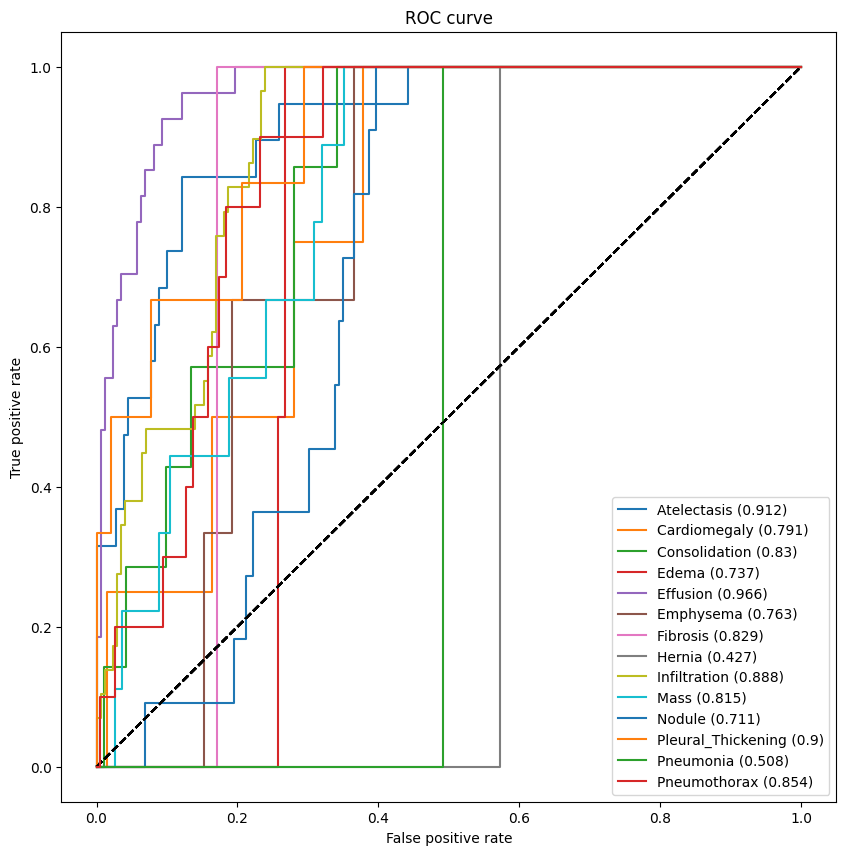

[0.9121837743530096,
 0.7908163265306123,
 0.8304959289415248,
 0.7373737373737373,
 0.9659601798330122,
 0.7631133671742809,
 0.8291457286432161,
 0.42713567839195976,
 0.8880822746521477,
 0.8150087260034904,
 0.7109187109187111,
 0.9003436426116838,
 0.507537688442211,
 0.8542105263157895]

In [ ]:
custom_objects = {'weighted_loss': get_weighted_loss}
Densenet_With_WL_model_2=load_model('/content/drive/MyDrive/tmp/checkpoint/DenseNet_With_WL_FT_model.h5', custom_objects=custom_objects)
Densenet_with_WL_predicted_vals_2 = Densenet_With_WL_model_2.predict(val_generator, batch_size = len(val_generator))
get_roc_curve(labels, Densenet_with_WL_predicted_vals_2, val_generator.labels)

### Vision Transformers With Weighted Loss

In [ ]:
from tensorflow.keras.optimizers import Adam
from vit_keras import vit


train_generator = get_train_generator(train_data, IMAGE_DIR, "Image", labels, target_w = 224, target_h = 224)
val_generator, test_generator  = get_test_and_valid_generator(val_data, test_data, train_data, IMAGE_DIR, "Image", labels, target_w = 224, target_h = 224)



# Load the ViT model
Vit_with_WL_model = vit.vit_l32(weights='imagenet21k', image_size=224,activation='sigmoid', pretrained=True, include_top=True, pretrained_top=False, classes=len(labels))



# Define callbacks
checkpoint = ModelCheckpoint('/content/drive/MyDrive/tmp/checkpoint/model_VitTransf_model_with_WL.h5', monitor='val_loss', save_best_only=True, save_weights_only=False, mode='min', verbose=1)
early_stop = EarlyStopping(monitor='val_loss', patience=15, mode='min', verbose=1)
log_dir = "/content/drive/MyDrive/logs/fit/" + "Vit_with_WL" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
# Compile the model
Vit_with_WL_model.compile(optimizer=Adam(learning_rate=0.001), loss=get_weighted_loss(pos_weights, neg_weights), metrics=[ tf.keras.metrics.AUC(multi_label = True)])
STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=val_generator.n//val_generator.batch_size
# Train the model
Vit_with_WL_model.fit(train_generator, validation_data=val_generator, steps_per_epoch = STEP_SIZE_TRAIN, epochs=20, validation_steps=STEP_SIZE_VALID , callbacks=[checkpoint, early_stop,tensorboard_callback])


/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


getting train generator...
Found 1000 validated image filenames.
getting valid and test generators...
Found 1000 validated image filenames.
Found 200 validated image filenames.
Found 420 validated image filenames.
1315932802/1315932802 [==============================] - 6s 0us/step
Epoch 1/20
62/62 [==============================] - ETA: 0s - loss: 0.9071 - auc: 0.4314
Epoch 1: val_loss improved from inf to 0.84643, saving model to /content/drive/MyDrive/tmp/checkpoint/model_VitTransf_model_with_WL.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 476s 6s/step - loss: 0.9071 - auc: 0.4314 - val_loss: 0.8464 - val_auc: 0.4104
Epoch 2/20
62/62 [==============================] - ETA: 0s - loss: 0.8591 - auc: 0.4621
Epoch 2: val_loss improved from 0.84643 to 0.83978, saving model to /content/drive/MyDrive/tmp/checkpoint/model_VitTransf_model_with_WL.h5
62/62 [==============================] - 230s 4s/step - loss: 0.8591 - auc: 0.4621 - val_loss: 0.8398 - val_auc: 0.4395
Epoch 3/20
62/62 [==============================] - ETA: 0s - loss: 0.8569 - auc: 0.4467
Epoch 3: val_loss improved from 0.83978 to 0.82553, saving model to /content/drive/MyDrive/tmp/checkpoint/model_VitTransf_model_with_WL.h5
62/62 [==============================] - 213s 3s/step - loss: 0.8569 - auc: 0.4467 - val_loss: 0.8255 - val_auc: 0.4296
Epoch 4/20
62/62 [==============================] - ETA: 0s - loss: 0.8634 - auc: 0.4469
Epoch 4: val_loss did not improve from 0.82553
62/62 [==============================] - 104s 2s

4/4 [==============================] - 12s 472ms/step


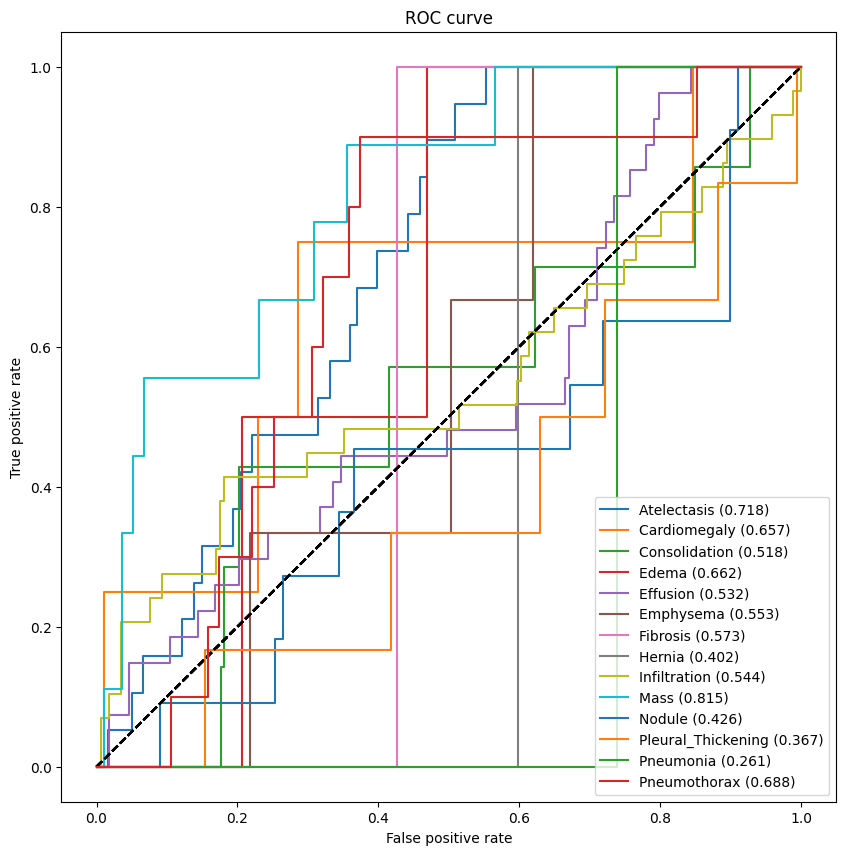

[0.7176504797906368,
 0.6568877551020408,
 0.5181347150259067,
 0.6616161616161615,
 0.5322200813530293,
 0.5532994923857868,
 0.5728643216080402,
 0.40201005025125625,
 0.5436579955636217,
 0.8150087260034904,
 0.4256854256854257,
 0.36683848797250856,
 0.2613065326633166,
 0.6878947368421052]

In [ ]:
custom_objects = {'weighted_loss': get_weighted_loss}

Vit_with_WL_model=load_model('/content/drive/MyDrive/tmp/checkpoint/model_VitTransf_model_with_WL.h5', custom_objects=custom_objects)
Vit_with_WL_predicted_vals = Vit_with_WL_model.predict(val_generator_for_VIT, batch_size = len(val_generator_for_VIT))
get_roc_curve(labels, Vit_with_WL_predicted_vals, val_generator_for_VIT.labels)

### RNN With Weighted Loss

In [ ]:
Rnn_with_WL_model = tf.keras.Sequential([
  tf.keras.Input(shape=(320,320,3)),
  tf.keras.layers.Reshape(target_shape=(320, 960)),
  tf.keras.layers.GRU(128),
  tf.keras.layers.Dense(128, activation='relu'),
  tf.keras.layers.Dropout(0.2,input_shape=(128,)),
  tf.keras.layers.Dense(len(labels), activation='sigmoid')
])
Rnn_with_WL_model.compile(optimizer='adam', loss=get_weighted_loss(pos_weights, neg_weights), metrics=['accuracy' ,tf.keras.metrics.AUC(multi_label = True) ])

checkpoint = ModelCheckpoint('/content/drive/MyDrive/tmp/checkpoint/RNN_with_WL_model.h5', monitor='val_loss', save_best_only=True, save_weights_only=False, mode='min', verbose=1)
early_stop = EarlyStopping(monitor='val_loss', patience=10, mode='min', verbose=1)
log_dir = "/content/drive/MyDrive/logs/fit/" + "RNN_with_WL" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

history = Rnn_with_WL_model.fit(train_generator, epochs=20, validation_data=val_generator, callbacks=[checkpoint, early_stop ,tensorboard_callback])

Epoch 1/20
63/63 [==============================] - ETA: 0s - loss: 0.8926 - accuracy: 0.0630 - auc_1: 0.4798
Epoch 1: val_loss improved from inf to 0.82758, saving model to /content/drive/MyDrive/tmp/checkpoint/RNN_with_WL_model.h5
63/63 [==============================] - 32s 395ms/step - loss: 0.8926 - accuracy: 0.0630 - auc_1: 0.4798 - val_loss: 0.8276 - val_accuracy: 0.2300 - val_auc_1: 0.6064
Epoch 2/20


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


63/63 [==============================] - ETA: 0s - loss: 0.8340 - accuracy: 0.1300 - auc_1: 0.5484
Epoch 2: val_loss improved from 0.82758 to 0.79598, saving model to /content/drive/MyDrive/tmp/checkpoint/RNN_with_WL_model.h5
63/63 [==============================] - 24s 376ms/step - loss: 0.8340 - accuracy: 0.1300 - auc_1: 0.5484 - val_loss: 0.7960 - val_accuracy: 0.0750 - val_auc_1: 0.6812
Epoch 3/20
63/63 [==============================] - ETA: 0s - loss: 0.8269 - accuracy: 0.1000 - auc_1: 0.5604
Epoch 3: val_loss improved from 0.79598 to 0.78943, saving model to /content/drive/MyDrive/tmp/checkpoint/RNN_with_WL_model.h5
63/63 [==============================] - 21s 332ms/step - loss: 0.8269 - accuracy: 0.1000 - auc_1: 0.5604 - val_loss: 0.7894 - val_accuracy: 0.0450 - val_auc_1: 0.6291
Epoch 4/20
63/63 [==============================] - ETA: 0s - loss: 0.8141 - accuracy: 0.1510 - auc_1: 0.6162
Epoch 4: val_loss improved from 0.78943 to 0.77850, saving model to /content/drive/MyDrive/

4/4 [==============================] - 4s 726ms/step


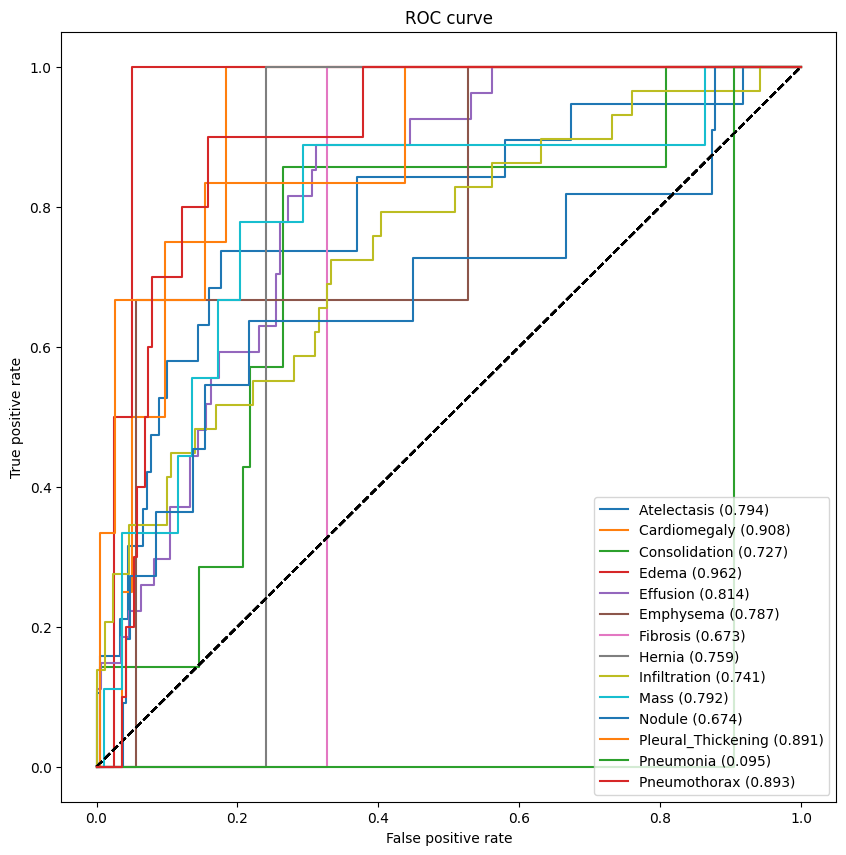

[0.7935446350683338,
 0.9081632653061225,
 0.7268689859363434,
 0.9621212121212122,
 0.8137443802183686,
 0.7868020304568528,
 0.6733668341708543,
 0.7587939698492463,
 0.7414801371244203,
 0.7923211169284468,
 0.673881673881674,
 0.890893470790378,
 0.09547738693467334,
 0.893157894736842]

In [ ]:
custom_objects = {'weighted_loss': get_weighted_loss}
Rnn_with_WL_model=load_model('/content/drive/MyDrive/tmp/checkpoint/RNN_with_WL_model.h5', custom_objects=custom_objects)

Rnn_with_WL_model_predicted_vals = Rnn_with_WL_model.predict(val_generator, steps = len(val_generator))

get_roc_curve(labels, Rnn_with_WL_model_predicted_vals, val_generator.labels)

### CNN+RNN With Weighted Loss

In [ ]:
cnn = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=(320, 320, 3)),
    tf.keras.layers.MaxPooling2D((2, 2)),

])

# Calculate the shape of the output feature map from the CNN
cnn_output_shape = cnn.layers[-1].output_shape


rnn = tf.keras.Sequential([
    tf.keras.layers.Reshape(target_shape=(cnn_output_shape[1], cnn_output_shape[2] * cnn_output_shape[3])),
    tf.keras.layers.GRU(128),

])

# Combine the CNN and RNN
combined_model_with_WL = tf.keras.Sequential([
    cnn,
    rnn,
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(len(labels), activation='sigmoid')
])

combined_model_with_WL.compile(optimizer='adam', loss=get_weighted_loss(pos_weights, neg_weights), metrics=['accuracy'])

checkpoint = ModelCheckpoint('/content/drive/MyDrive/tmp/checkpoint/model_CNNRNN_with_WL.h5', monitor='val_loss', save_best_only=True, save_weights_only=False, mode='min', verbose=1)
early_stop = EarlyStopping(monitor='val_loss', patience=10, mode='min', verbose=1)
log_dir = "/content/drive/MyDrive/logs/fit/" + "cnnrnn_with_WL "+datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

history = combined_model_with_WL.fit(train_generator, epochs=20, validation_data=val_generator, callbacks=[checkpoint, early_stop,tensorboard_callback])

Epoch 1/20
63/63 [==============================] - ETA: 0s - loss: 0.8859 - accuracy: 0.0420
Epoch 1: val_loss improved from inf to 0.85627, saving model to /content/drive/MyDrive/tmp/checkpoint/model_CNNRNN_with_WL.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


63/63 [==============================] - 496s 8s/step - loss: 0.8859 - accuracy: 0.0420 - val_loss: 0.8563 - val_accuracy: 0.1950
Epoch 2/20
63/63 [==============================] - ETA: 0s - loss: 0.8608 - accuracy: 0.0650
Epoch 2: val_loss improved from 0.85627 to 0.82341, saving model to /content/drive/MyDrive/tmp/checkpoint/model_CNNRNN_with_WL.h5
63/63 [==============================] - 22s 347ms/step - loss: 0.8608 - accuracy: 0.0650 - val_loss: 0.8234 - val_accuracy: 0.1600
Epoch 3/20
63/63 [==============================] - ETA: 0s - loss: 0.8427 - accuracy: 0.0830
Epoch 3: val_loss improved from 0.82341 to 0.80966, saving model to /content/drive/MyDrive/tmp/checkpoint/model_CNNRNN_with_WL.h5
63/63 [==============================] - 22s 345ms/step - loss: 0.8427 - accuracy: 0.0830 - val_loss: 0.8097 - val_accuracy: 0.1650
Epoch 4/20
63/63 [==============================] - ETA: 0s - loss: 0.8395 - accuracy: 0.1190
Epoch 4: val_loss did not improve from 0.80966
63/63 [==========

4/4 [==============================] - 5s 1s/step


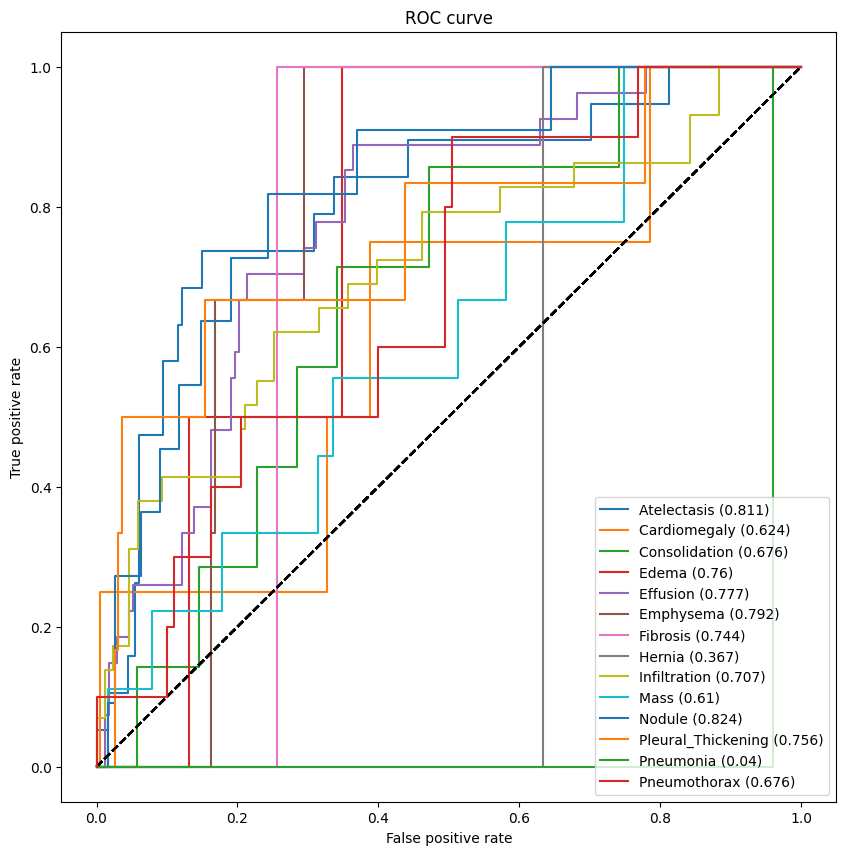

[0.8109915673160802,
 0.6237244897959184,
 0.6757957068837898,
 0.76010101010101,
 0.7771355170199101,
 0.7918781725888324,
 0.7437185929648241,
 0.3668341708542714,
 0.707199032062916,
 0.6096567771960443,
 0.823953823953824,
 0.7560137457044674,
 0.04020100502512558,
 0.6757894736842105]

In [ ]:
custom_objects = {'weighted_loss': get_weighted_loss}
combined_model_with_WL=load_model('/content/drive/MyDrive/tmp/checkpoint/model_CNNRNN_with_WL.h5', custom_objects=custom_objects)
Rnn_Cnn_WL_predicted_vals = combined_model_with_WL.predict(val_generator, steps = len(val_generator))

get_roc_curve(labels, Rnn_Cnn_WL_predicted_vals, val_generator.labels)

## AUC Vizualisation per model With Wighted Loss Optimisation


In [ ]:
custom_objects = {'weighted_loss': get_weighted_loss}
Densenet_model_with_WL=load_model('/content/drive/MyDrive/tmp/checkpoint/DenseNet_with_WL_FE_model.h5', custom_objects=custom_objects)
Densenet_model_2_with_WL_=load_model('/content/drive/MyDrive/tmp/checkpoint//DenseNet_With_WL_FT_model.h5', custom_objects=custom_objects)
rnn_cnn_with_WL_model = load_model('/content/drive/MyDrive/tmp/checkpoint/model_CNNRNN_with_WL.h5', custom_objects=custom_objects)
rnn_with_WL_model = load_model('/content/drive/MyDrive/tmp/checkpoint/RNN_with_WL_model.h5', custom_objects=custom_objects)
vit_with_WL_model = load_model('/content/drive/MyDrive/tmp/checkpoint/model_VitTransf_model_with_WL.h5', custom_objects=custom_objects)

In [ ]:
Densenet_with_WL_predicted_vals = Densenet_model_with_WL.predict(val_generator, batch_size = len(val_generator))
Densenet2_with_WL_predicted_vals = Densenet_model_2_with_WL_.predict(val_generator, batch_size = len(val_generator))
rnn_cnn_with_WL_predicted_vals = rnn_cnn_with_WL_model.predict(val_generator, batch_size = len(val_generator))
rnn_with_WL_predicted_vals = rnn_with_WL_model.predict(val_generator, batch_size = len(val_generator))
vit_with_WL_predicted_vals = vit_with_WL_model.predict(val_generator_for_VIT, steps = len(val_generator_for_VIT))

4/4 [==============================] - 18s 836ms/step


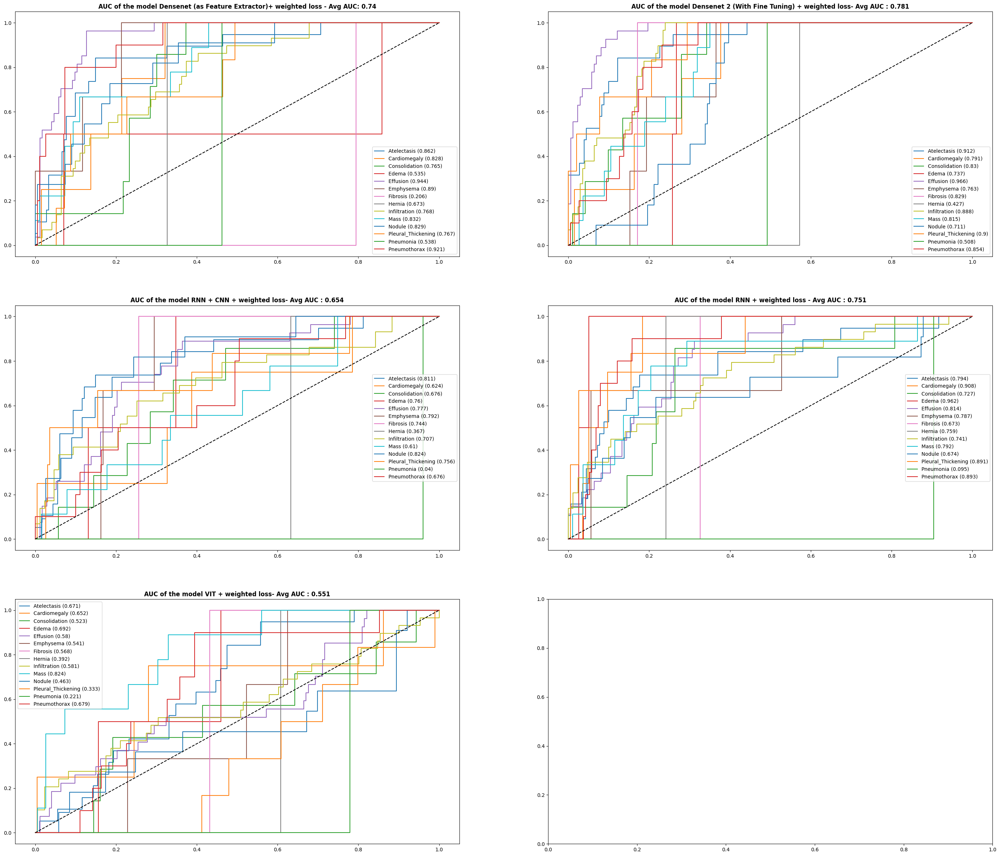

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_auc_score, roc_curve

fig, ((ax1, ax2), (ax3, ax4), (ax5, _)) = plt.subplots(3, 2, figsize=(35, 30))

auc_values_dense_net = []
auc_values_dense_net2 = []
auc_values_rnn_cnn = []
auc_values_rnn = []
auc_values_vit = []

for i in range(len(labels)):
    gt = (val_generator.labels)[:, i]
    gt_vit = (val_generator_for_VIT.labels)[:, i]
    pred_dense_net = Densenet_with_WL_predicted_vals[:, i]
    pred_dense_net2 = Densenet2_with_WL_predicted_vals[:, i]
    pred_rnn_cnn = rnn_cnn_with_WL_predicted_vals[:, i]
    pred_rnn = rnn_with_WL_predicted_vals[:, i]
    pred_vit = vit_with_WL_predicted_vals[:, i]

    auc_roc_dense_net = roc_auc_score(gt, pred_dense_net)
    auc_roc_dense_net2 = roc_auc_score(gt, pred_dense_net2)
    auc_roc_rnn_cnn = roc_auc_score(gt, pred_rnn_cnn)
    auc_roc_rnn = roc_auc_score(gt, pred_rnn)
    auc_roc_vit = roc_auc_score(gt, pred_vit)

    fpr_dense_net, tpr_dense_net, _ = roc_curve(gt, pred_dense_net)
    fpr_dense_net2, tpr_dense_net2, _ = roc_curve(gt, pred_dense_net2)
    fpr_rnn_cnn, tpr_rnn_cnn, _ = roc_curve(gt, pred_rnn_cnn)
    fpr_rnn, tpr_rnn, _ = roc_curve(gt, pred_rnn)
    fpr_vit, tpr_vit, _ = roc_curve(gt_vit, pred_vit)

    # Append AUC values to lists
    auc_values_dense_net.append(auc_roc_dense_net)
    auc_values_dense_net2.append(auc_roc_dense_net2)
    auc_values_rnn_cnn.append(auc_roc_rnn_cnn)
    auc_values_rnn.append(auc_roc_rnn)
    auc_values_vit.append(auc_roc_vit)

    ax1.plot(fpr_dense_net, tpr_dense_net, label = labels[i] +  " (" + str(round(auc_roc_dense_net,3)) + ")")
    ax2.plot(fpr_dense_net2, tpr_dense_net2, label = labels[i] +  " (" + str(round(auc_roc_dense_net2,3)) + ")")
    ax3.plot(fpr_rnn_cnn, tpr_rnn_cnn, label = labels[i] +  " (" + str(round(auc_roc_rnn_cnn,3)) + ")")
    ax4.plot(fpr_rnn, tpr_rnn, label = labels[i] +  " (" + str(round(auc_roc_rnn,3)) + ")")
    ax5.plot(fpr_vit, tpr_vit, label = labels[i] +  " (" + str(round(auc_roc_vit,3)) + ")")

# Calculate average AUC values
avg_auc_dense_net = round(np.average(auc_values_dense_net) , 3)
avg_auc_dense_net2 = round(np.average(auc_values_dense_net2), 3)
avg_auc_rnn_cnn = round(np.average(auc_values_rnn_cnn), 3)
avg_auc_rnn = round(np.average(auc_values_rnn), 3)
avg_auc_vit = round(np.average(auc_values_vit), 3)

# plot titles
ax1.set_title(f"AUC of the model Densenet (as Feature Extractor)+ weighted loss - Avg AUC: {avg_auc_dense_net}", fontweight='bold')
ax2.set_title(f"AUC of the model Densenet 2 (With Fine Tuning) + weighted loss- Avg AUC : {avg_auc_dense_net2}", fontweight='bold')
ax3.set_title(f"AUC of the model RNN + CNN + weighted loss- Avg AUC : {avg_auc_rnn_cnn}", fontweight='bold')
ax4.set_title(f"AUC of the model RNN + weighted loss - Avg AUC : {avg_auc_rnn}", fontweight='bold')
ax5.set_title(f"AUC of the model VIT + weighted loss- Avg AUC : {avg_auc_vit}", fontweight='bold')
for ax in [ax1, ax2, ax3, ax4, ax5]:
  ax.legend(loc='best')
  ax.plot([0, 1], [0, 1], 'k--')

plt.show()


## Model optimization by Data Augmentation

In [ ]:
def get_Augmented_train_generator(df, image_dir, x_col, y_cols, shuffle=True, batch_size=16, seed=1, target_w = 320, target_h = 320):

    print("getting train generator...")
    # normalize images
    image_generator = ImageDataGenerator(samplewise_center=True,
                              samplewise_std_normalization=True,
                              horizontal_flip = True,
                              vertical_flip = False,
                              height_shift_range= 0.05,
                              width_shift_range=0.1,
                              rotation_range=5,
                              shear_range = 0.1,
                              fill_mode = 'reflect',
                              zoom_range=0.15)


    generator = image_generator.flow_from_dataframe(
            dataframe=df,
            directory=image_dir,
            x_col=x_col,
            y_col=y_cols,
            class_mode="raw",
            batch_size=batch_size,
            shuffle=shuffle,
            seed=seed,
            target_size=(target_w,target_h))

    return generator

def get_Augmented_test_and_valid_generator(valid_df, test_df, train_df, image_dir, x_col, y_cols, sample_size=16, batch_size=64, seed=1, target_w = 320, target_h = 320):


    print("getting valid and test generators...")

    raw_train_generator = ImageDataGenerator().flow_from_dataframe(
        dataframe=train_df,
        directory=IMAGE_DIR,
        x_col="Image",
        y_col=labels,
        class_mode="raw",
        batch_size=sample_size,
        shuffle=True,
        target_size=(target_w, target_h))


    batch = raw_train_generator.next()
    data_sample = batch[0]


    image_generator = ImageDataGenerator(samplewise_center=True,
                              samplewise_std_normalization=True,
                              horizontal_flip = True,
                              vertical_flip = False,
                              height_shift_range= 0.05,
                              width_shift_range=0.1,
                              rotation_range=5,
                              shear_range = 0.1,
                              fill_mode = 'reflect',
                              zoom_range=0.15)

    image_generator.fit(data_sample)

    valid_generator = image_generator.flow_from_dataframe(
            dataframe=valid_df,
            directory=image_dir,
            x_col=x_col,
            y_col=y_cols,
            class_mode="raw",
            batch_size=batch_size,
            shuffle=False,
            seed=seed,
            validate_filenames=True,
            target_size=(target_w,target_h))

    test_generator = image_generator.flow_from_dataframe(
            dataframe=test_df,
            directory=image_dir,
            x_col=x_col,
            y_col=y_cols,
            class_mode="raw",
            batch_size=1,
            shuffle=False,
            seed=seed,
            target_size=(target_w,target_h))

    return valid_generator, test_generator


In [ ]:
IMAGE_DIR = "/content/drive/MyDrive/Data/images-small/"
Augmented_train_generator = get_Augmented_train_generator(train_data, IMAGE_DIR, "Image", labels)
Augmented_val_generator, Augmented_test_generator = get_Augmented_test_and_valid_generator(val_data, test_data, train_data, IMAGE_DIR, "Image", labels)

getting train generator...
Found 1000 validated image filenames.
getting valid and test generators...
Found 1000 validated image filenames.
Found 200 validated image filenames.
Found 420 validated image filenames.


### Densenet FineTuning with Data Augmentation

In [ ]:
# create the base pre-trained model
base_model = DenseNet121(weights='imagenet', include_top=False)

# We freeze last 9 layers
for layer in base_model.layers[:-9]:
    layer.trainable= False

x = base_model.output
x = GlobalAveragePooling2D()(x)
# Add L2 regularization to a Dense layer
x = Dense(512, activation='relu', kernel_regularizer=regularizers.l2(0.01))(x)

# Add L2 regularization to another Dense layer
x = Dense(256, activation='relu', kernel_regularizer=regularizers.l2(0.01))(x)

# Add L1 regularization to a Dense layer
x = Dense(128, activation='relu', kernel_regularizer=regularizers.l1(0.01))(x)

predictions = Dense(len(labels), activation="sigmoid")(x)
# define the callbacks

Densenet_model_2_with_DA = Model(inputs=base_model.input, outputs=predictions)
checkpoint = ModelCheckpoint('/content/drive/MyDrive/tmp/checkpoint/DenseNet_FT_DA_model.h5', monitor='val_loss', save_best_only=True, save_weights_only=False, mode='min', verbose=1)
early_stop = EarlyStopping(monitor='val_loss', patience=10, mode='min', verbose=1)
log_dir = "/content/drive/MyDrive/logs/fit/" + "densenset2_with_DA "+ datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)


Densenet_model_2_with_DA.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy' ,tf.keras.metrics.AUC(multi_label = True)])
STEP_SIZE_TRAIN=Augmented_train_generator.n//Augmented_train_generator.batch_size
STEP_SIZE_VALID=Augmented_val_generator.n//Augmented_val_generator.batch_size

history = Densenet_model_2_with_DA.fit(Augmented_train_generator, validation_data=Augmented_val_generator , steps_per_epoch = STEP_SIZE_TRAIN, epochs=20, validation_steps=STEP_SIZE_VALID ,callbacks=[checkpoint, early_stop,tensorboard_callback] )


Epoch 1/20
62/62 [==============================] - ETA: 0s - loss: 16.3140 - accuracy: 0.1098 - auc_1: 0.5285
Epoch 1: val_loss improved from inf to 6.34851, saving model to /content/drive/MyDrive/tmp/checkpoint/DenseNet_FT_DA_model.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 347s 5s/step - loss: 16.3140 - accuracy: 0.1098 - auc_1: 0.5285 - val_loss: 6.3485 - val_accuracy: 0.1458 - val_auc_1: 0.5742
Epoch 2/20
62/62 [==============================] - ETA: 0s - loss: 2.5398 - accuracy: 0.1016 - auc_1: 0.6068
Epoch 2: val_loss improved from 6.34851 to 0.49702, saving model to /content/drive/MyDrive/tmp/checkpoint/DenseNet_FT_DA_model.h5
62/62 [==============================] - 57s 925ms/step - loss: 2.5398 - accuracy: 0.1016 - auc_1: 0.6068 - val_loss: 0.4970 - val_accuracy: 0.0833 - val_auc_1: 0.5979
Epoch 3/20
62/62 [==============================] - ETA: 0s - loss: 0.3468 - accuracy: 0.0986 - auc_1: 0.6486
Epoch 3: val_loss improved from 0.49702 to 0.27197, saving model to /content/drive/MyDrive/tmp/checkpoint/DenseNet_FT_DA_model.h5
62/62 [==============================] - 54s 866ms/step - loss: 0.3468 - accuracy: 0.0986 - auc_1: 0.6486 - val_loss: 0.2720 - val_accuracy: 0.0833 - val_auc_1: 0.6143
Epoch 4/20
62/62 

4/4 [==============================] - 10s 2s/step


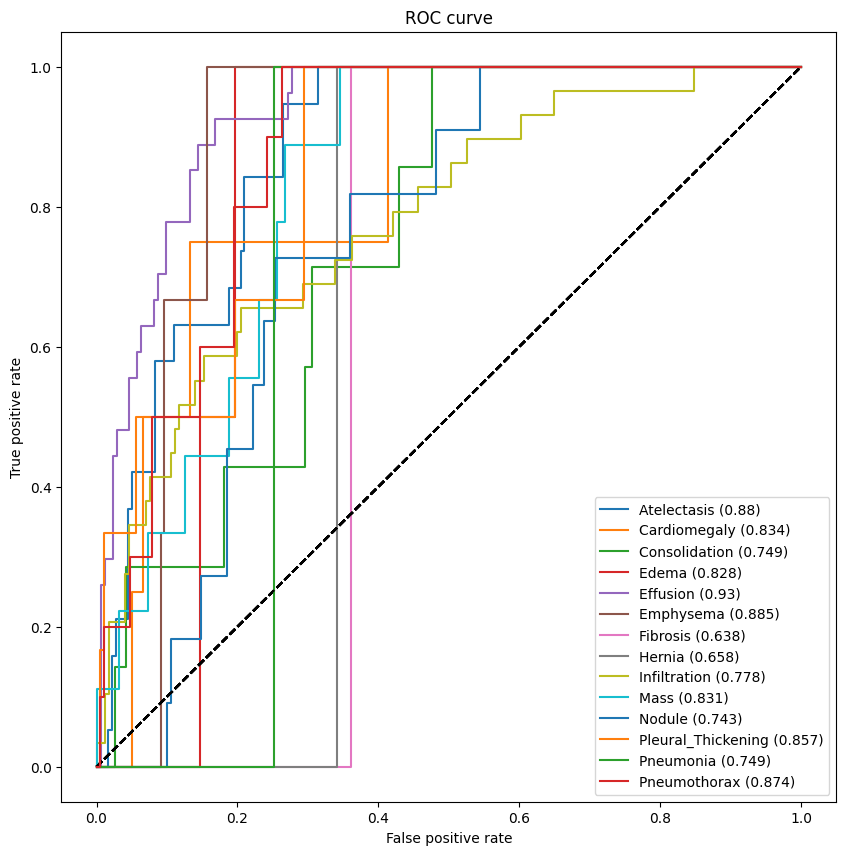

[0.8796161674905496,
 0.8341836734693878,
 0.7490747594374537,
 0.8282828282828283,
 0.9304217512309998,
 0.8849407783417935,
 0.6381909547738693,
 0.6582914572864322,
 0.7783827384553338,
 0.8312972658522396,
 0.7431457431457431,
 0.8573883161512027,
 0.7487437185929648,
 0.8736842105263158]

In [ ]:
Densenet_model_2_with_DA=load_model('/content/drive/MyDrive/tmp/checkpoint/DenseNet_FT_DA_model.h5')
Densenet_model_2_with_DA_predicted_vals = Densenet_model_2_with_DA.predict(Augmented_val_generator, batch_size = len(Augmented_val_generator))
get_roc_curve(labels, Densenet_model_2_with_DA_predicted_vals, Augmented_val_generator.labels)

### RNN with Data Augmentation


In [ ]:
Rnn_model_with_DA = tf.keras.Sequential([
  tf.keras.Input(shape=(320,320,3)),
  tf.keras.layers.Reshape(target_shape=(320, 960)),
  tf.keras.layers.GRU(128),
  tf.keras.layers.Dense(128, activation='relu'),
  tf.keras.layers.Dropout(0.2,input_shape=(128,)),
  tf.keras.layers.Dense(len(labels), activation='sigmoid')
])

checkpoint = ModelCheckpoint('/content/drive/MyDrive/tmp/checkpoint/RNN_DA_model.h5', monitor='val_loss', save_best_only=True, save_weights_only=False, mode='min', verbose=1)
early_stop = EarlyStopping(monitor='val_loss', patience=10, mode='min', verbose=1)
log_dir = "/content/drive/MyDrive/logs/fit/" + "RNN_with_DA "+ datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)


Rnn_model_with_DA.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy' ,tf.keras.metrics.AUC(multi_label = True)])
STEP_SIZE_TRAIN=Augmented_train_generator.n//Augmented_train_generator.batch_size
STEP_SIZE_VALID=Augmented_val_generator.n//Augmented_val_generator.batch_size

history = Rnn_model_with_DA.fit(Augmented_train_generator, validation_data=Augmented_val_generator , steps_per_epoch = STEP_SIZE_TRAIN, epochs=20, validation_steps=STEP_SIZE_VALID ,callbacks=[checkpoint, early_stop,tensorboard_callback] )

Epoch 1/20
62/62 [==============================] - ETA: 0s - loss: 0.2199 - accuracy: 0.1667 - auc: 0.4799
Epoch 1: val_loss improved from inf to 0.16274, saving model to /content/drive/MyDrive/tmp/checkpoint/RNN_DA_model.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


62/62 [==============================] - 317s 5s/step - loss: 0.2199 - accuracy: 0.1667 - auc: 0.4799 - val_loss: 0.1627 - val_accuracy: 0.0833 - val_auc: 0.4381
Epoch 2/20
62/62 [==============================] - ETA: 0s - loss: 0.1847 - accuracy: 0.1961 - auc: 0.5170
Epoch 2: val_loss did not improve from 0.16274
62/62 [==============================] - 45s 728ms/step - loss: 0.1847 - accuracy: 0.1961 - auc: 0.5170 - val_loss: 0.1635 - val_accuracy: 0.1250 - val_auc: 0.4786
Epoch 3/20
62/62 [==============================] - ETA: 0s - loss: 0.1815 - accuracy: 0.1748 - auc: 0.5055
Epoch 3: val_loss improved from 0.16274 to 0.16095, saving model to /content/drive/MyDrive/tmp/checkpoint/RNN_DA_model.h5
62/62 [==============================] - 48s 772ms/step - loss: 0.1815 - accuracy: 0.1748 - auc: 0.5055 - val_loss: 0.1609 - val_accuracy: 0.2135 - val_auc: 0.5314
Epoch 4/20
62/62 [==============================] - ETA: 0s - loss: 0.1817 - accuracy: 0.2053 - auc: 0.4976
Epoch 4: val_loss

4/4 [==============================] - 9s 2s/step


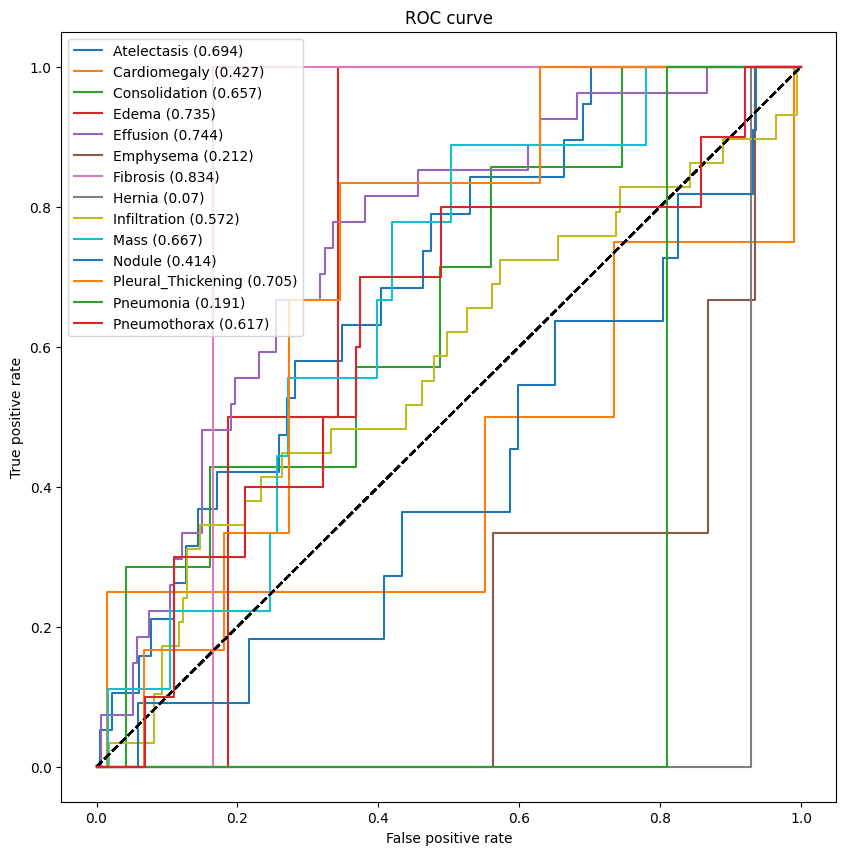

[0.6943879034603082,
 0.4272959183673469,
 0.6565507031828275,
 0.7348484848484849,
 0.74373795761079,
 0.2115059221658206,
 0.8341708542713568,
 0.07035175879396982,
 0.5720911474087518,
 0.6672484002326934,
 0.4136604136604137,
 0.7053264604810996,
 0.19095477386934678,
 0.6168421052631579]

In [ ]:
Rnn_model_with_DA = load_model('/content/drive/MyDrive/tmp/checkpoint/RNN_DA_model.h5')
Rnn_model_with_DA_predicted_vals = Rnn_model_with_DA.predict(Augmented_val_generator, batch_size = len(Augmented_val_generator))
get_roc_curve(labels, Rnn_model_with_DA_predicted_vals, Augmented_val_generator.labels)

## AUC Vizualisation per model with Data Augmentation

In [ ]:
densenet_model_2_with_DA_=load_model('/content/drive/MyDrive/tmp/checkpoint/DenseNet_FT_DA_model.h5')
rnn_with_DA_model = load_model('/content/drive/MyDrive/tmp/checkpoint/RNN_DA_model.h5')


In [ ]:
densenet2_with_DA_predicted_vals = densenet_model_2_with_DA_.predict(Augmented_val_generator, batch_size = len(Augmented_val_generator))
rnn_with_DA_predicted_vals = rnn_with_DA_model.predict(Augmented_val_generator, batch_size = len(Augmented_val_generator))

4/4 [==============================] - 8s 1s/step


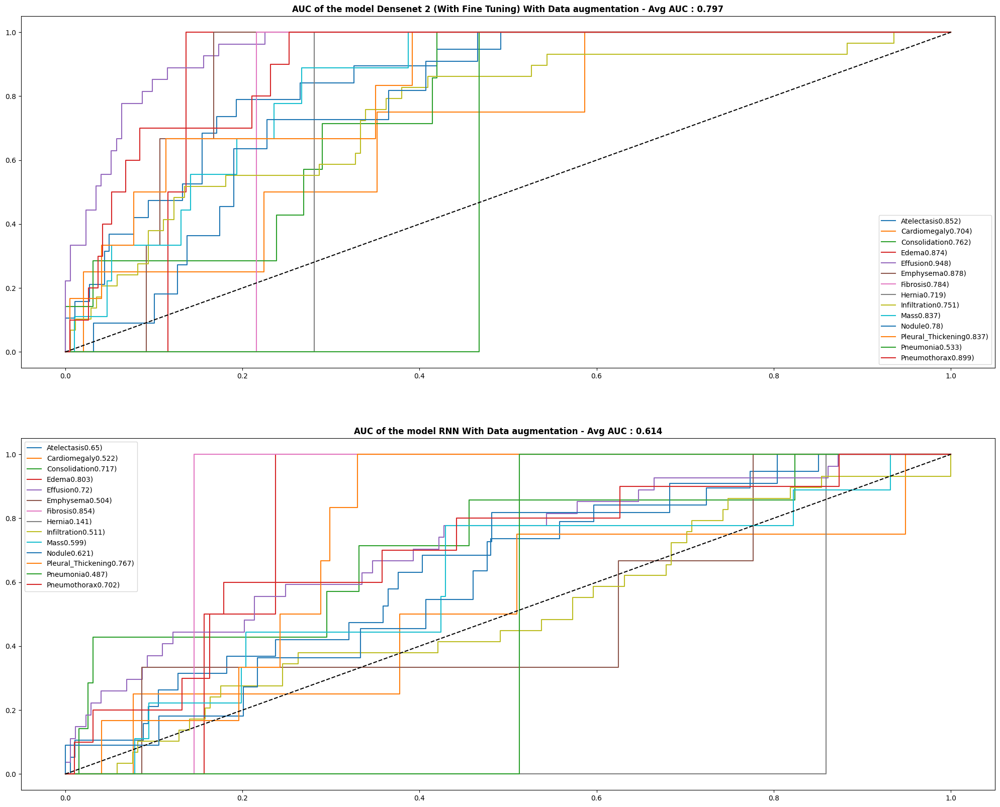

In [ ]:


fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(25, 20))

auc_values_dense_net2 = []
auc_values_rnn = []

for i in range(len(labels)):
    gt = (Augmented_val_generator.labels)[:, i]
    pred_dense_net2 = densenet2_with_DA_predicted_vals[:, i]
    pred_rnn = rnn_with_DA_predicted_vals[:, i]

    auc_roc_dense_net2 = roc_auc_score(gt, pred_dense_net2)
    auc_roc_rnn = roc_auc_score(gt, pred_rnn)

    fpr_dense_net2, tpr_dense_net2, _ = roc_curve(gt, pred_dense_net2)
    fpr_rnn, tpr_rnn, _ = roc_curve(gt, pred_rnn)

    # Append AUC values to lists
    auc_values_dense_net2.append(auc_roc_dense_net2)
    auc_values_rnn.append(auc_roc_rnn)

    ax1.plot(fpr_dense_net2, tpr_dense_net2, label = labels[i] +  " (" +  str(round(auc_roc_dense_net2,3)) + ")")
    ax2.plot(fpr_rnn, tpr_rnn, label = labels[i] +  " (" + str(round(auc_roc_rnn,3)) + ")")

# Calculate average AUC values
avg_auc_dense_net2 = round(np.average(auc_values_dense_net2), 3)
avg_auc_rnn = round(np.average(auc_values_rnn), 3)

# plot titles
ax1.set_title(f"AUC of the model Densenet 2 (With Fine Tuning) With Data augmentation - Avg AUC : {avg_auc_dense_net2}", fontweight='bold')
ax2.set_title(f"AUC of the model RNN With Data augmentation - Avg AUC : {avg_auc_rnn}", fontweight='bold')
for ax in [ax1, ax2]:
  ax.legend(loc='best')
  ax.plot([0, 1], [0, 1], 'k--')

plt.show()


# Results or Model Selection

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
log_dir = "/content/drive/MyDrive/logs/fit/"

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/logs/fit/  --port 6020

Reusing TensorBoard on port 6020 (pid 1811), started 2:09:15 ago. (Use '!kill 1811' to kill it.)

<IPython.core.display.Javascript object>

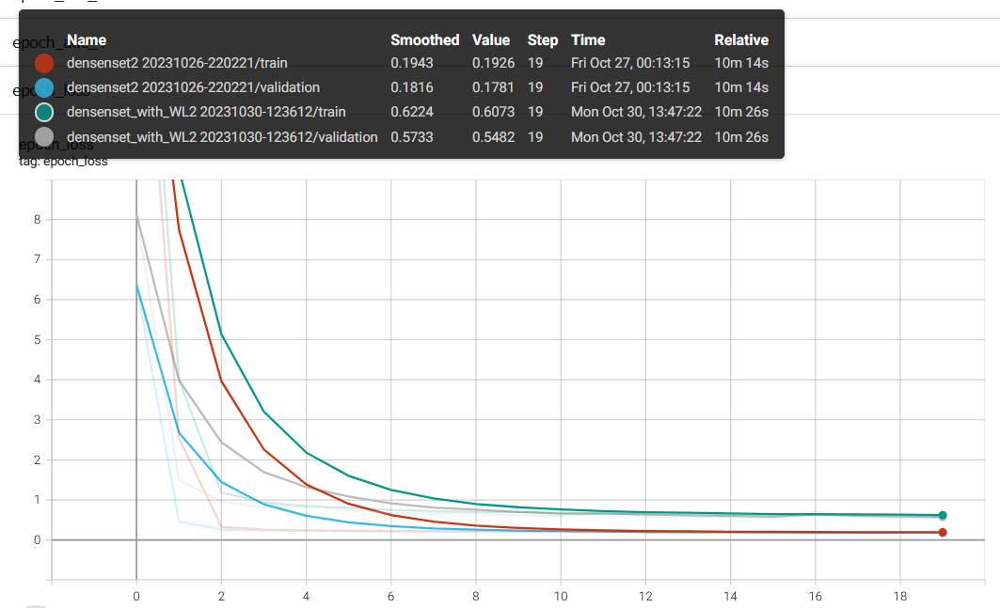




By comparing the average AUC of each block, the Train and the Val Loss, we can clearly identify that 2 models stand out:
 * Densenet with fine tuning  **Avg AUC 0.842**  ; **Train Loss 0.19** ; **Val Loss 0.17**
 * Densenet with fine tuning with the weighted loss **Avg AUC 0.781** ;**Train Loss 0.60** ; **Val Loss 0.54**

We can also note that these 2 models show interesting results in relation to each other because when not considering the hernia  and pneumonia labels , for which the models predict randomly, the avg AUC are a little closer (0.833 for Densenet with fine tuning and 0.864 ).

Given the trade-off between the two models, it appears that **the first model (without weighted loss optimisation) performs better in terms of AUC and validation loss**. Although the second model attempted to address the class imbalance, its higher loss and only slightly lower AUC may indicate that the weighted loss strategy did not significantly improve the overall performance of the model.


**Model choice:** Given the higher AUC and significantly lower validation loss, the **Densenet with fine-tuning** appears to be more favourable for the final predictions, as it has better overall performance based on the measurements provided.

**NB:** We are aware that the validation data are not sufficient to properly evaluate our models, for computational reasons we have limited ourselves to a few data and above all to apply the architectures seen in class.

# Model test

In [72]:
IMAGE_DIR = "/content/drive/MyDrive/Data/images-small/"
labels_to_show = ['Cardiomegaly']#np.take(labels, np.argsort(auc_rocs)[::-1])[:4]
Densenet_model_2=load_model('/content/drive/MyDrive/tmp/checkpoint/DenseNet_FT_model_weights.h5')
Densenet2_predicted_train = Densenet_model_2.predict(train_generator, batch_size = len(train_generator))

63/63 [==============================] - 588s 9s/step


In [73]:
def get_threshold(labels, predicted_vals, true_vals):

    threshold = []
    for i in range(len(labels)):

          gt = true_vals[:, i]
          pred = predicted_vals[:, i]
          auc_roc = roc_auc_score(gt, pred)
          fpr_rf, tpr_rf, tr = roc_curve(gt, pred)
          threshold.append(tr.mean())
    print(f" Threshold : {threshold}")
    return threshold

threshold = get_threshold(labels, Densenet2_predicted_train, train_generator.labels)

 Threshold : [0.09356099, 0.04787678, 0.04650478, 0.03958776, 0.102978654, 0.04941133, 0.04722181, 0.14946309, 0.12896654, 0.045061648, 0.05188355, 0.04679164, 0.05033796, 0.050274566]


1/1 [==============================] - 1s 525ms/step


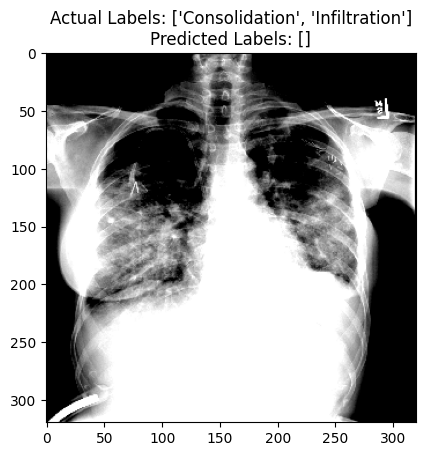

1/1 [==============================] - 0s 464ms/step


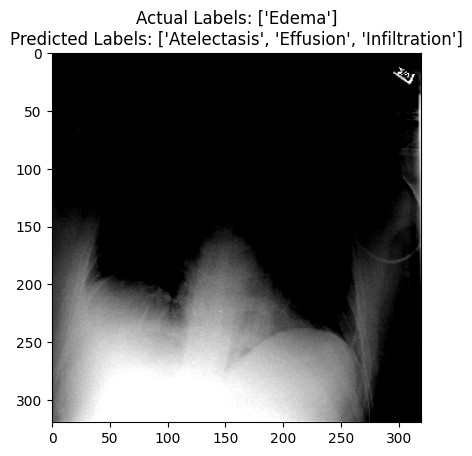

1/1 [==============================] - 0s 368ms/step


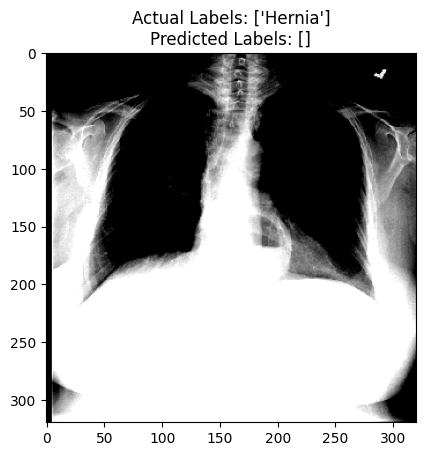

1/1 [==============================] - 0s 263ms/step


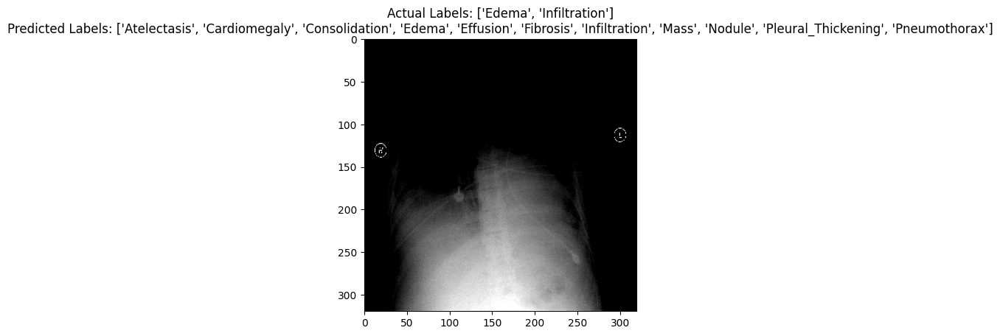

1/1 [==============================] - 0s 285ms/step


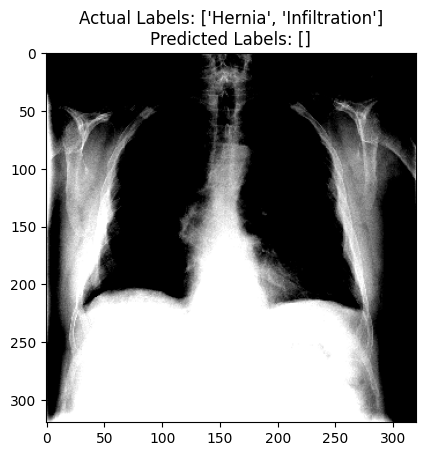

1/1 [==============================] - 0s 272ms/step


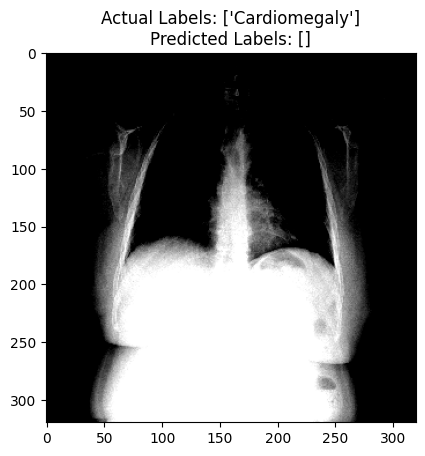

1/1 [==============================] - 0s 466ms/step


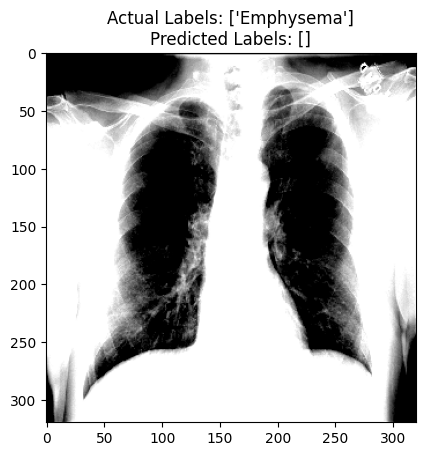

1/1 [==============================] - 0s 476ms/step


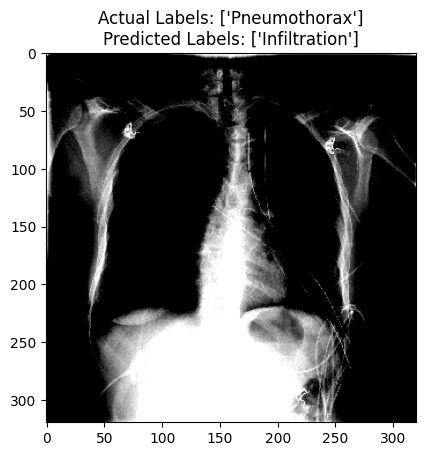

1/1 [==============================] - 0s 439ms/step


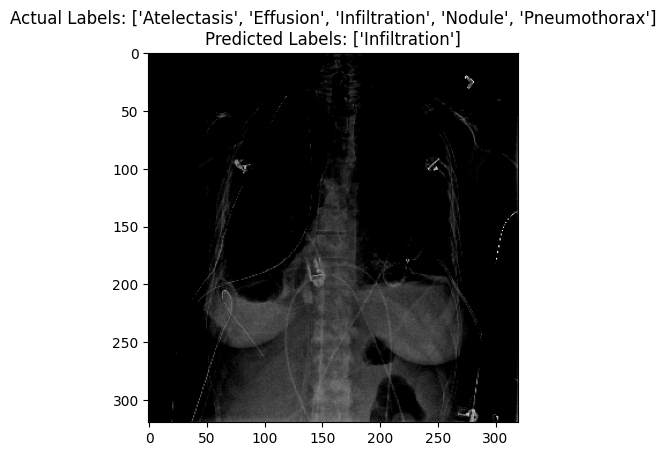

1/1 [==============================] - 0s 474ms/step


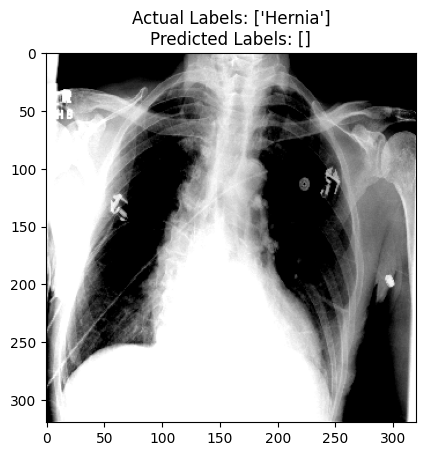

1/1 [==============================] - 1s 528ms/step


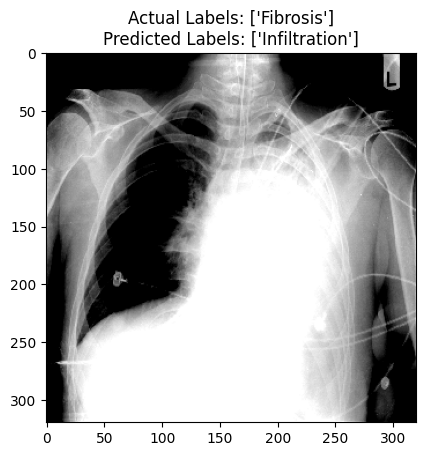

1/1 [==============================] - 1s 538ms/step


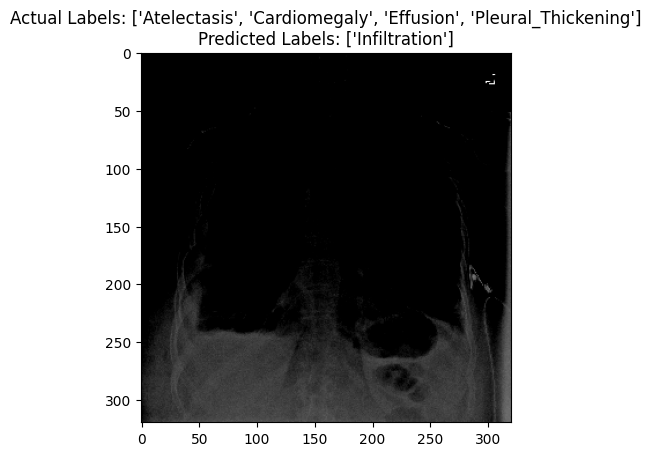

1/1 [==============================] - 1s 519ms/step


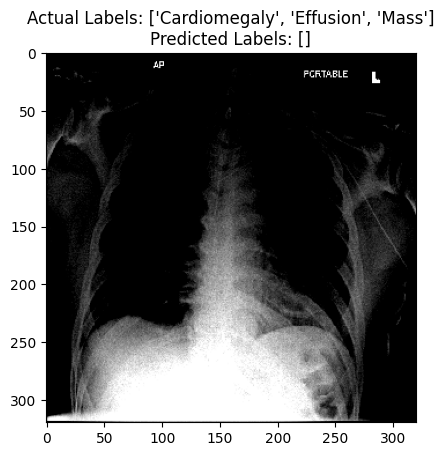

1/1 [==============================] - 1s 525ms/step


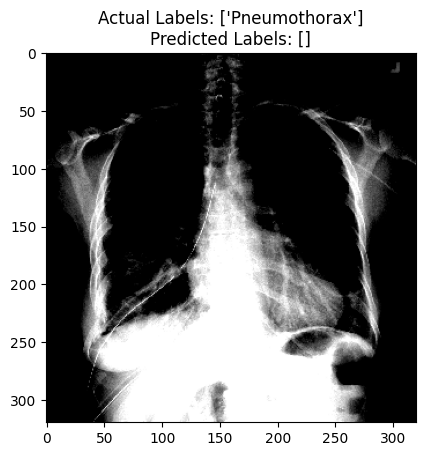

1/1 [==============================] - 0s 459ms/step


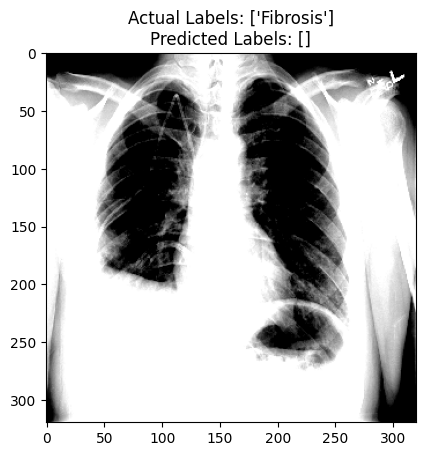

1/1 [==============================] - 0s 482ms/step


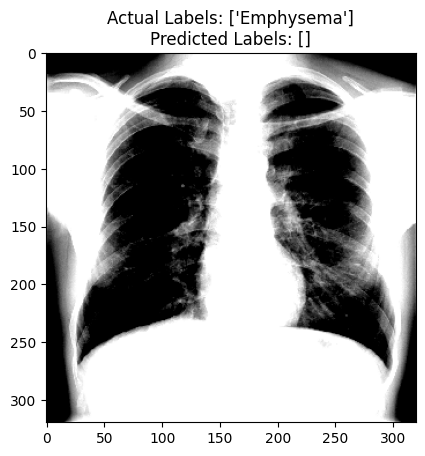

1/1 [==============================] - 0s 476ms/step


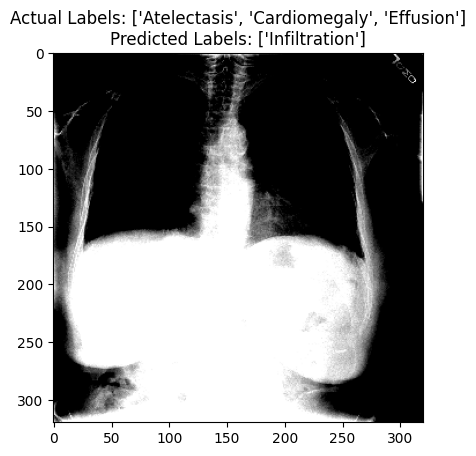

1/1 [==============================] - 0s 480ms/step


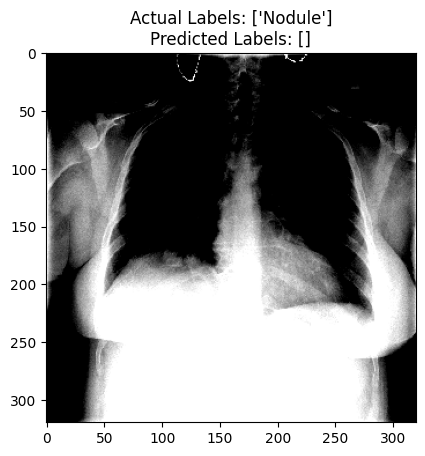

1/1 [==============================] - 0s 340ms/step


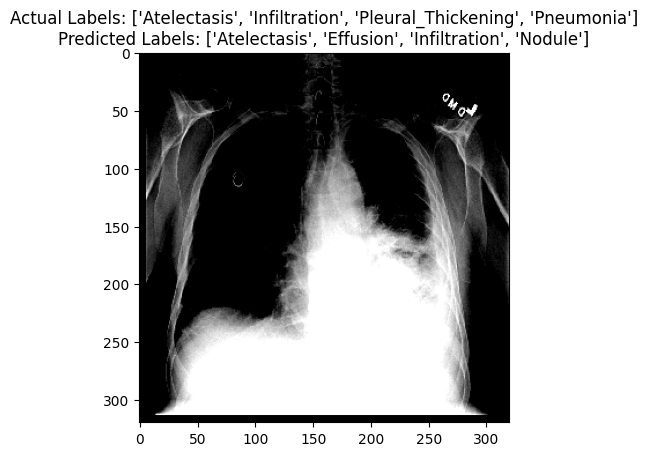

1/1 [==============================] - 0s 271ms/step


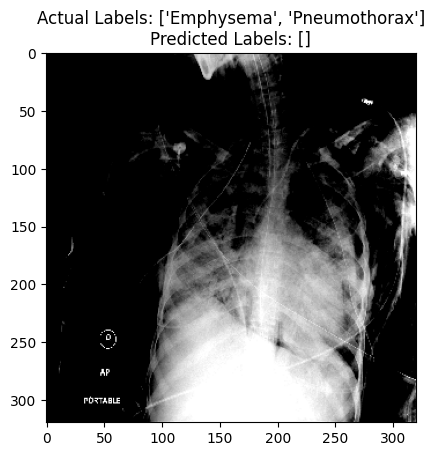

1/1 [==============================] - 0s 266ms/step


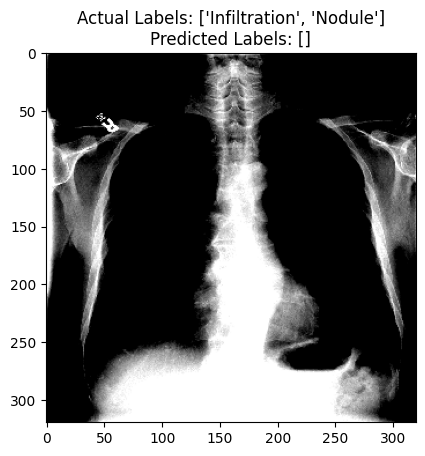

1/1 [==============================] - 0s 279ms/step


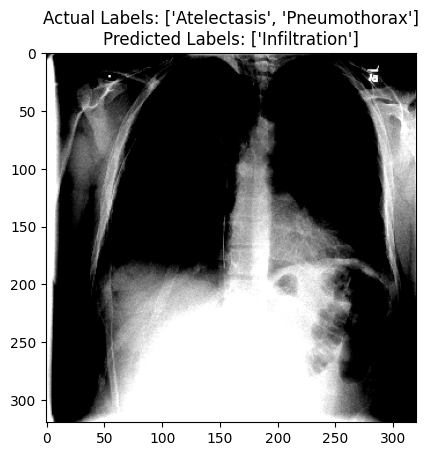

1/1 [==============================] - 0s 272ms/step


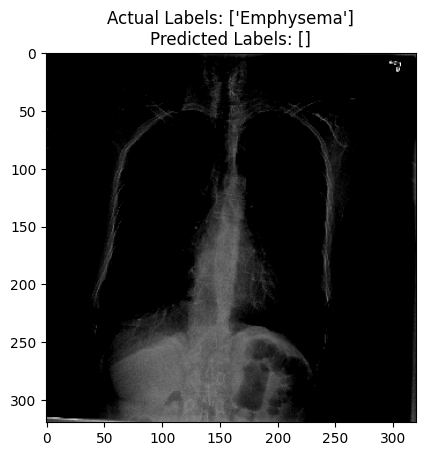

1/1 [==============================] - 0s 265ms/step


Exception ignored in: <function _xla_gc_callback at 0x7cf126e6dea0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/jax/_src/lib/__init__.py", line 101, in _xla_gc_callback
    def _xla_gc_callback(*args):
KeyboardInterrupt: 


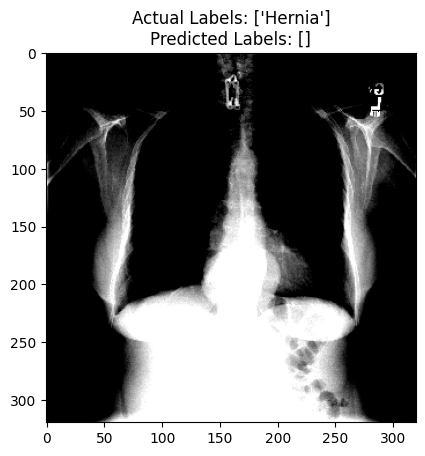

1/1 [==============================] - 0s 275ms/step


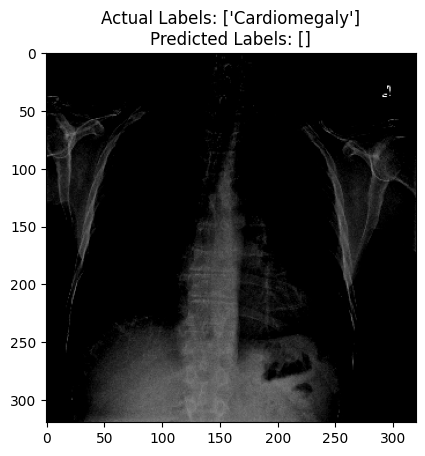

1/1 [==============================] - 0s 282ms/step


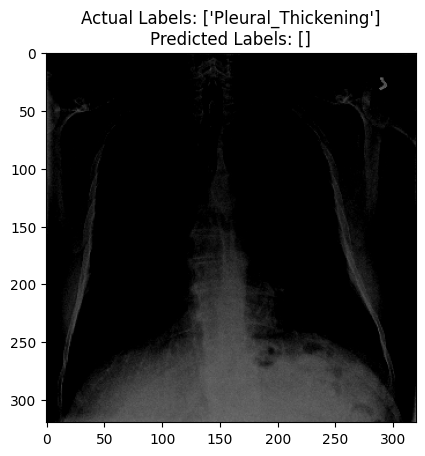

1/1 [==============================] - 0s 268ms/step


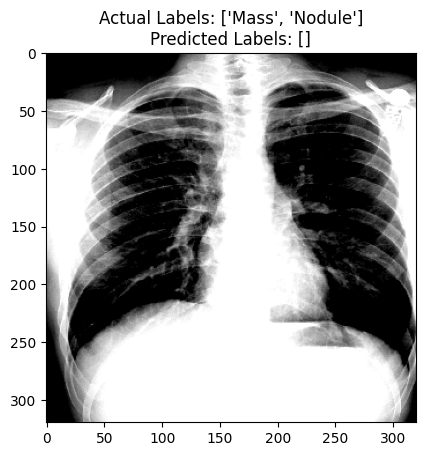

1/1 [==============================] - 0s 389ms/step


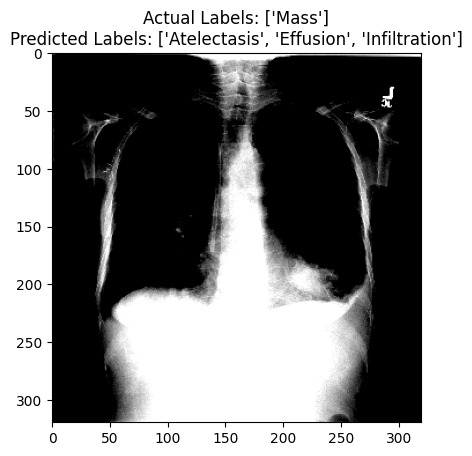

1/1 [==============================] - 0s 457ms/step


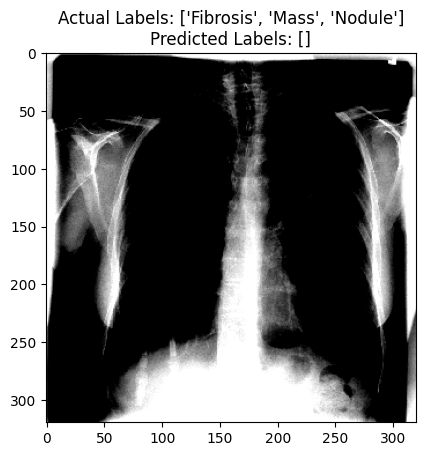

1/1 [==============================] - 0s 482ms/step


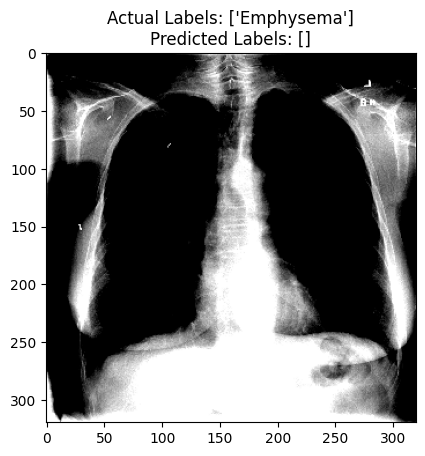

1/1 [==============================] - 0s 470ms/step


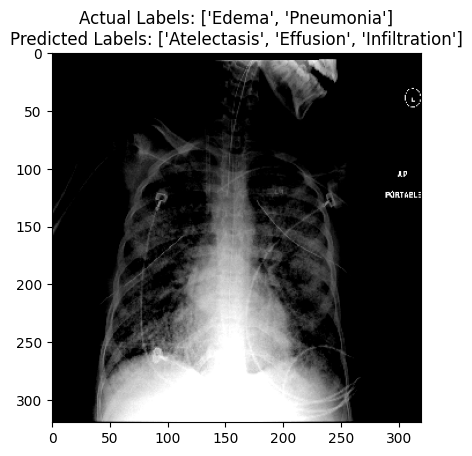

1/1 [==============================] - 0s 474ms/step


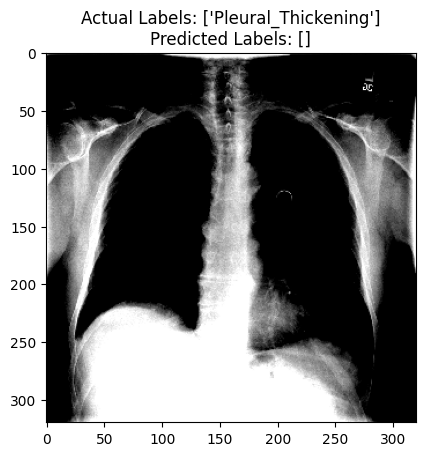

1/1 [==============================] - 0s 481ms/step


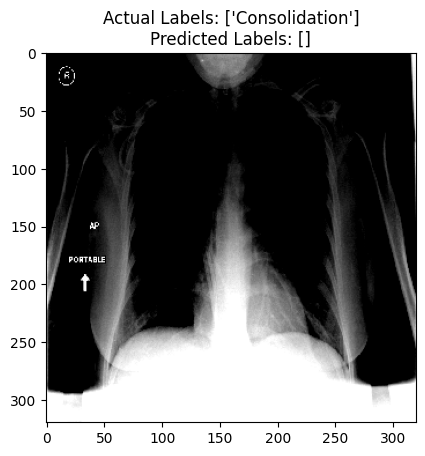

1/1 [==============================] - 0s 475ms/step


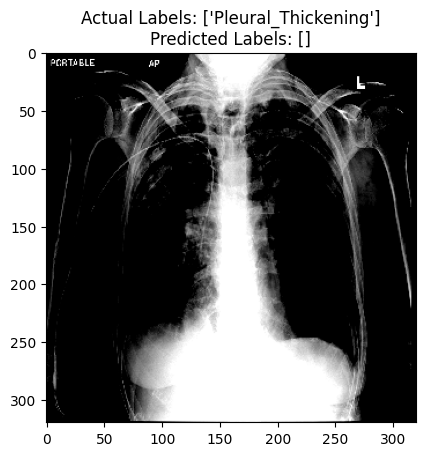

1/1 [==============================] - 0s 288ms/step


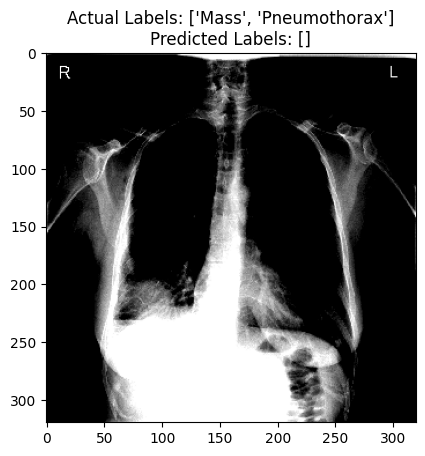

1/1 [==============================] - 0s 274ms/step


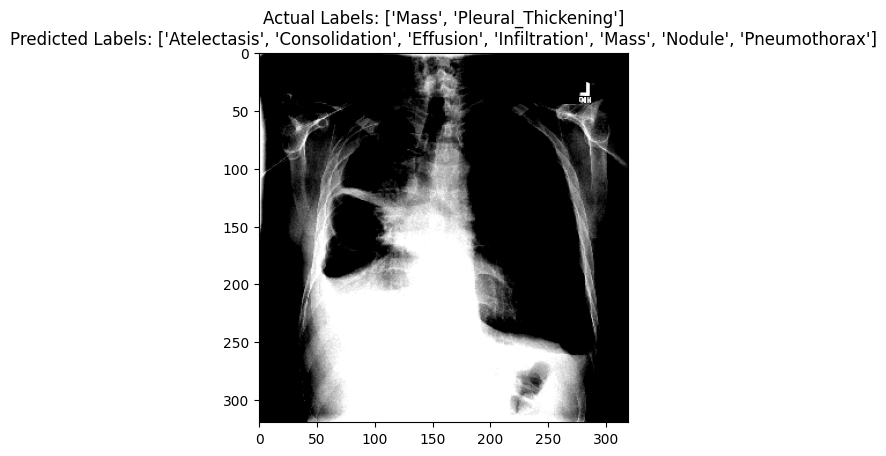

1/1 [==============================] - 0s 283ms/step


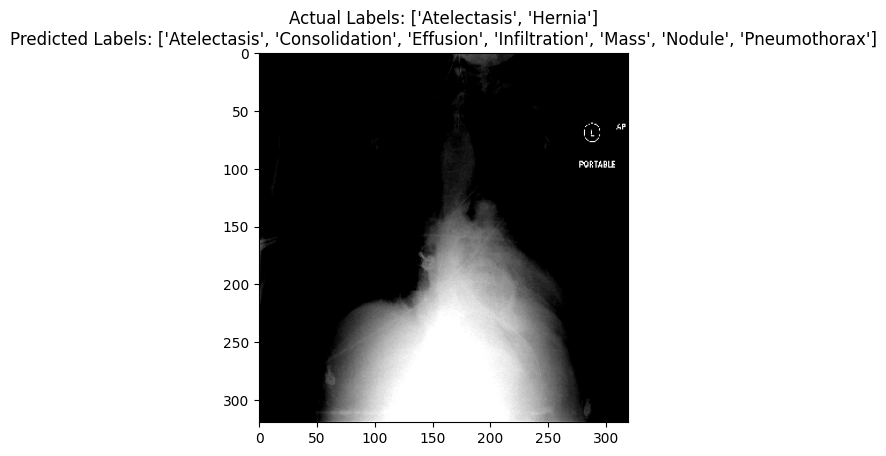

1/1 [==============================] - 0s 275ms/step


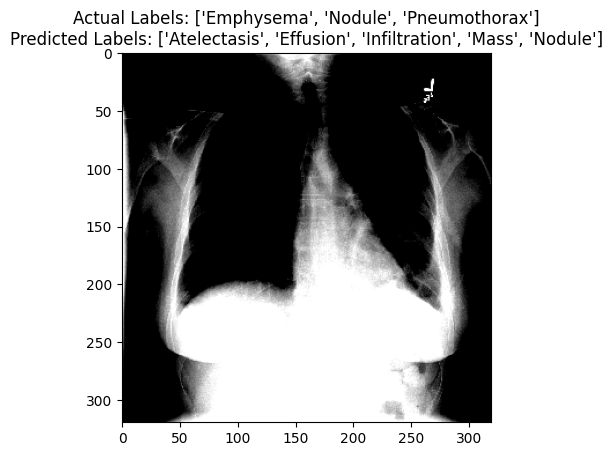

1/1 [==============================] - 0s 278ms/step


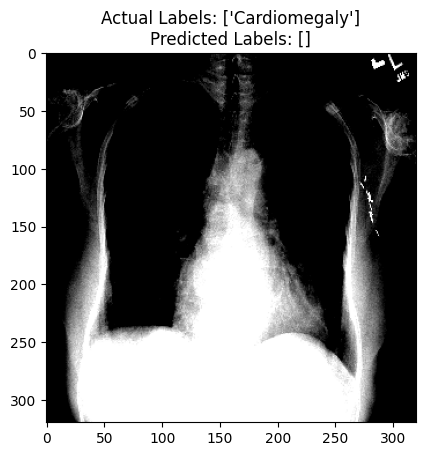

1/1 [==============================] - 1s 670ms/step


KeyboardInterrupt: ignored

In [83]:
#nb_loop = int(len(test_generator)/10)
for i in range(len(test_generator)):
    #print(len(test_generator))
    #print(train_generator)

    test_sample = test_generator[i][0]
    predictions = Densenet_model_2.predict(test_sample)

    #print(threshold)
    #print(predictions[0])
    #print(labels)

    # Apply threshold for binary predictions
    predicted_labels_score = (predictions[0] > threshold).astype(int)

    #print(predicted_labels_score)

    predicted_labels_index = np.where(predicted_labels_score == 1)[0]

    #print(predicted_labels_index)

    predicted_labels = []

    for index in predicted_labels_index:
      predicted_labels.append(labels[index])

    #print(predicted_labels)

    # Get the actual labels for the i-th sample
    actual_labels = test_generator[i][1][0]

    #print(f"Actual labels: {actual_labels}")

    ground_truth_labels_index = np.where(actual_labels == 1)[0]

    ground_truth_labels = []

    for index in ground_truth_labels_index:
      ground_truth_labels.append(labels[index])

    # Get the image corresponding to the i-th sample
    image = test_sample[0]

    # Plot the image
    plt.imshow(image)
    plt.title(f"Actual Labels: {ground_truth_labels}\nPredicted Labels: {predicted_labels}")
    plt.show()

In [ ]:
X_test = test_data['Image']
y_test = test_data[labels]

#y_pred = Densenet_model_2.predict(test_generator, steps = len(test_generator.filenames))

<ipython-input-27-d463751b3cbf>:4: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  y_pred = Densenet_model_2.predict_generator(test_generator, steps = len(test_generator.filenames))


In [ ]:
#import shutil

#test_dir = "/content/drive/MyDrive/Data/test_dir/"

#for image_name in test_data['Image']:
#  image_path = "/content/drive/MyDrive/Data/images-small/" + image_name
#  copy_path = test_dir + image_name
#  shutil.copy(image_path, copy_path)